# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

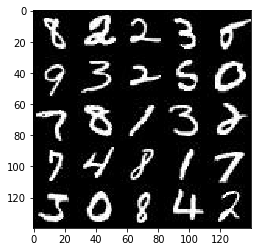

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

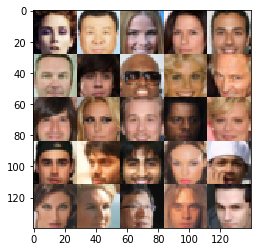

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.3.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], name='input')
    z_data = tf.placeholder(tf.float32, [None, z_dim], name='z_data')
    learn_rate = tf.placeholder(tf.float32, name='learning_rate')
    return inputs, z_data, learn_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.framework.ops.Operation'>):
<tf.Operation 'assert_rank_2/Assert/Assert' type=Assert>
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
['File "/home/jigor/.conda/envs/dlnd/lib/python3.6/runpy.py", line 193, in _run_module_as_main\n    "__main__", mod_spec)', 'File "/home/jigor/.conda/envs/dlnd/lib/python3.6/runpy.py", line 85, in _run_code\n    exec(code, run_globals)', 'File "/home/jigor/.conda/envs/dlnd/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>\n    app.launch_new_instance()', 'File "/home/jigor/.conda/envs/dlnd/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance\n    app.start()', 'File "/home/jigor/.conda/envs/dlnd/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 477, in start\n    ioloop.IOLoop.instance().start()', 'File "/home/jigor/.conda/envs/dlnd/lib/p

### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [25]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    
    with tf.variable_scope('discriminator', reuse=reuse):
        #28x28x3
        #X = tf.layers.dropout(images,rate=0.4,training=True)
        X = tf.layers.conv2d(images, filters=128,strides=2,kernel_size=5, padding='same')
        #X = tf.layers.dropout(X,rate=0.6,training=True)
        #X = tf.layers.batch_normalization(X,  training=True)
        X = tf.maximum(0.2*X,X)
        #14x14x64
        #X = tf.layers.dropout(X,rate=0.5,training=True)
        #X = tf.layers.average_pooling2d(X,pool_size=3,padding='same',strides=2)#on
        X = tf.layers.conv2d(X, filters=256, strides=2, kernel_size=5, padding='same')
        ##X = tf.layers.dropout(X,rate=0.6,training=True)
        X = tf.layers.batch_normalization(X, training=True, fused=True)#off
        X = tf.maximum(0.2*X,X)
        #7x7x128
        
        #X = tf.layers.dropout(X,rate=0.5,training=True)
        #X = tf.layers.average_pooling2d(X,pool_size=5,padding='same',strides=1)
        X = tf.layers.conv2d(X, filters=512, strides=2, kernel_size=5, padding='same')
        
        X = tf.layers.batch_normalization(X, training=True,fused=True)
        X = tf.maximum(0.2*X,X)
        #X = tf.layers.max_pooling2d(X,pool_size=5,padding='same',strides=2)
        #4x4x256
        #X = tf.layers.dropout(X,rate=0.4,training=True)
        X = tf.layers.conv2d(X, filters=1024, strides=2, kernel_size=5, padding='same')
        X = tf.layers.batch_normalization(X, training=True)
        X = tf.maximum(0.2*X,X)
        
        #X = tf.layers.conv2d(X, filters=512, strides=1, kernel_size=5, padding='same')
        #X = tf.layers.batch_normalization(X, training=True)
        #X = tf.maximum(0.2*X,X)
        
        
        
        #X = tf.reduce_mean(X, (1,2))
        #logits = tf.reduce_mean(X, (1),keep_dims=True)
        #out = tf.sigmoid(logits)
        X = tf.reshape(X,(-1,2*2*1024))
        logits = tf.layers.dense(X, 1, activation=None)        
        out = tf.sigmoid(logits)
        #
        
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [26]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    alpha = 0.2
    with tf.variable_scope('generator', reuse= not is_train):
        X = tf.layers.dense(z, 7*7*1024)
        
        X = tf.reshape(X, (-1,7,7,1024))
        X = tf.layers.batch_normalization(X,training=is_train, fused=True)
        X = tf.maximum(alpha*X,X)
        
        X = tf.layers.conv2d_transpose(X, filters=512, kernel_size=5, strides=2, padding='same')
        X = tf.layers.batch_normalization(X, training=is_train, fused=True)
        X = tf.maximum(alpha*X, X)
        
        X = tf.layers.conv2d_transpose(X, filters=256, kernel_size=5, strides=2, padding='same')
        X = tf.layers.batch_normalization(X, training=is_train, fused=True)
        X = tf.maximum(alpha*X,X)
        
        X = tf.layers.conv2d_transpose(X, filters=128, kernel_size=5, strides=1, padding='same')
        X = tf.layers.batch_normalization(X, training=is_train)
        X = tf.maximum(alpha*X,X)
        
        logits = tf.layers.conv2d_transpose(X, filters=out_channel_dim, kernel_size=5, strides=1, padding='same')                        
        out = tf.tanh(logits)
        
        #X = tf.layers.dense(z, 3*3*512)
        
        #X = tf.reshape(X, (-1,3,3,512))
        #X = tf.layers.batch_normalization(X,training=is_train)
        #X = tf.maximum(alpha*X,X)
        
        #X = tf.layers.conv2d_transpose(X, filters=256, kernel_size=5, strides=2, padding='same')
        #X = tf.layers.batch_normalization(X, training=is_train)
        #X = tf.maximum(alpha*X, X)
        
        #X = tf.layers.conv2d_transpose(X, filters=128, kernel_size=5, strides=2, padding='same')
        #X = tf.layers.batch_normalization(X, training=is_train)
        #X = tf.maximum(alpha*X,X)
        
        #X = tf.layers.conv2d_transpose(X, filters=128, kernel_size=5, strides=2, padding='same')
        #X = tf.layers.batch_normalization(X, training=is_train)
        #X = tf.maximum(alpha*X,X)
        
        ##X = tf.layers.conv2d_transpose(X, filters=128, kernel_size=5, strides=1, padding='same')
        ##X = tf.layers.batch_normalization(X, training=is_train)
        ###X = tf.layers.dropout(X,0.5)
        ##X = tf.maximum(alpha*X,X)
        
        ##X = tf.layers.conv2d_transpose(X, filters=64, kernel_size=5, strides=1, padding='same')
        ##X = tf.layers.batch_normalization(X, training=is_train)
        ##X = tf.layers.dropout(X,0.5)
        ##X = tf.maximum(alpha*X,X)
        
        #logits = tf.layers.conv2d_transpose(X, filters=out_channel_dim, kernel_size=5, strides=1, padding='valid')                        
        #out  = tf.tanh(logits)
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [17]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_out = generator(z=input_z, out_channel_dim=out_channel_dim, is_train=True)
    dr_out, dr_logits = discriminator(input_real,reuse=False)
    df_out, df_logits = discriminator(g_out,reuse=True)
    
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.ones_like(df_logits), logits=df_logits))
    
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.zeros_like(df_logits), logits=df_logits))
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.ones_like(dr_logits)*0.9, logits=dr_logits))
    
    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    train_var = tf.trainable_variables()
    g_var = [x for x in train_var if x.name.startswith('generator')]
    d_var = [x for x in train_var if x.name.startswith('discriminator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_opt = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(d_loss, var_list=d_var)
        g_opt = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(g_loss, var_list=g_var)
    
    
    return d_opt, g_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [14]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    print(data_shape)
    _, image_width, image_height, image_channels = data_shape
                                                                                                   
    inputs, z_input, learn_rate = model_inputs(image_width,image_height,image_channels,z_dim)
    
    out_chanel_dim = image_channels
    
    d_loss, g_loss = model_loss(inputs,z_input, out_chanel_dim)
    
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            counter=0            
            d_loss_list=[]
            g_loss_list=[]
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                batch_images = batch_images * 2
                #zi = tf.random_uniform_initializer(-1,1)((batch_size,z_dim))                
                zi = np.random.uniform(-1,1,(batch_size,z_dim))    
               
                sess.run([d_opt,g_opt], feed_dict={inputs:batch_images,
                                                   z_input:zi,
                                                   learn_rate:learning_rate})
                #sess.run([g_opt,g_opt,g_opt] ,feed_dict={inputs:batch_images,
                #                                   z_input:zi,
                #                                   learn_rate:learning_rate})                
                
                
                    
                d,g = sess.run([d_loss, g_loss],feed_dict={inputs:batch_images,
                                                   z_input:zi,
                                                   learn_rate:learning_rate})
                d_loss_list.append(d)
                g_loss_list.append(g)
                
                if counter % 100 == 0:                    
                    show_generator_output(sess,25,z_input, out_chanel_dim, data_image_mode)
                    print("epoch=" + str(epoch_i) +
                          " batch=" + str(counter) + 
                          " d_loss="+str(np.mean(d_loss_list)) + 
                          " g_loss="+str(np.mean(g_loss_list)))
                
                counter+=1            
        print("Finished")
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

(60000, 28, 28, 1)


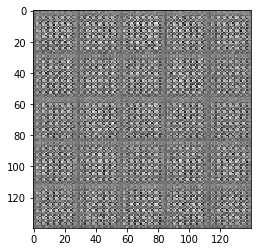

epoch=0 batch=0 d_loss=2.94625 g_loss=0.228474


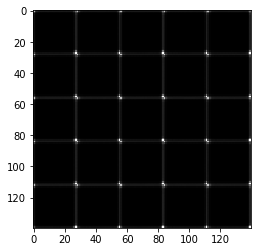

epoch=0 batch=100 d_loss=0.96643 g_loss=3.73547


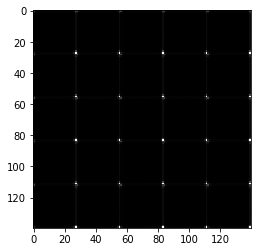

epoch=0 batch=200 d_loss=1.08691 g_loss=2.49413


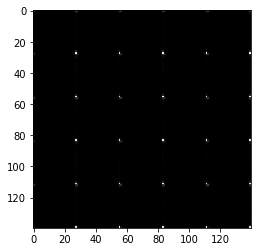

epoch=0 batch=300 d_loss=1.10559 g_loss=2.05386


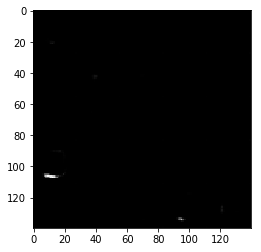

epoch=0 batch=400 d_loss=1.12043 g_loss=1.78377


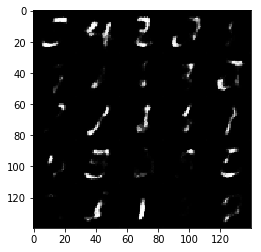

epoch=0 batch=500 d_loss=1.14682 g_loss=1.5895


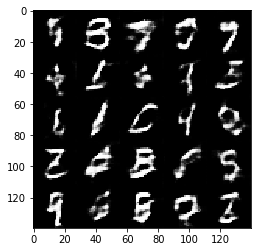

epoch=0 batch=600 d_loss=1.1541 g_loss=1.46632


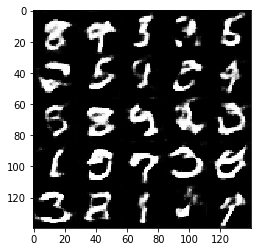

epoch=0 batch=700 d_loss=1.14068 g_loss=1.39567


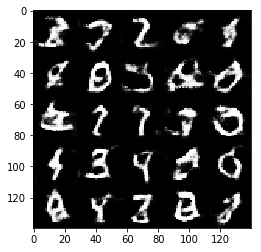

epoch=0 batch=800 d_loss=1.14107 g_loss=1.33234


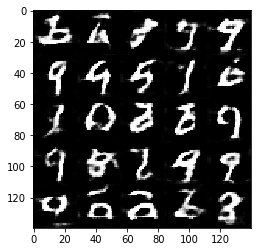

epoch=0 batch=900 d_loss=1.14133 g_loss=1.2832


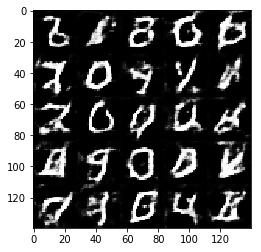

epoch=0 batch=1000 d_loss=1.14062 g_loss=1.24404


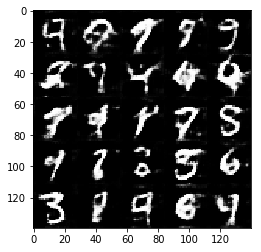

epoch=0 batch=1100 d_loss=1.13902 g_loss=1.21206


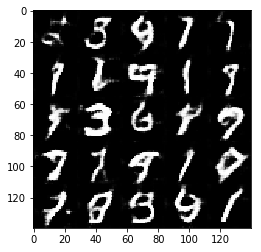

epoch=0 batch=1200 d_loss=1.13757 g_loss=1.18737


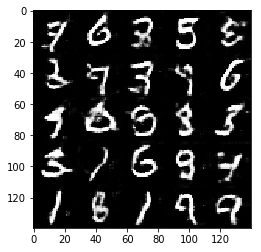

epoch=0 batch=1300 d_loss=1.13644 g_loss=1.16676


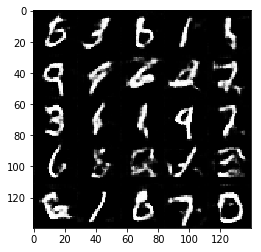

epoch=0 batch=1400 d_loss=1.13423 g_loss=1.14915


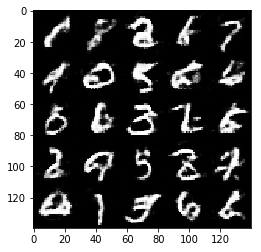

epoch=0 batch=1500 d_loss=1.13456 g_loss=1.12875


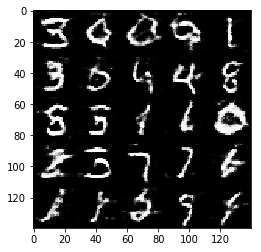

epoch=0 batch=1600 d_loss=1.13433 g_loss=1.11026


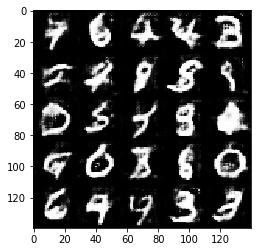

epoch=0 batch=1700 d_loss=1.13211 g_loss=1.10125


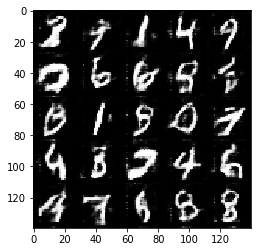

epoch=0 batch=1800 d_loss=1.13384 g_loss=1.08464


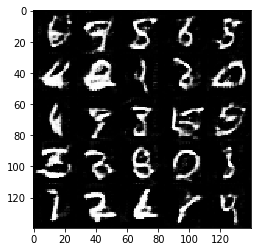

epoch=0 batch=1900 d_loss=1.13407 g_loss=1.07181


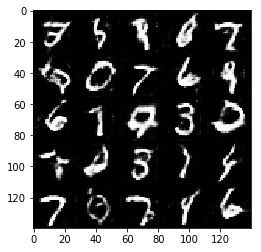

epoch=0 batch=2000 d_loss=1.13679 g_loss=1.05857


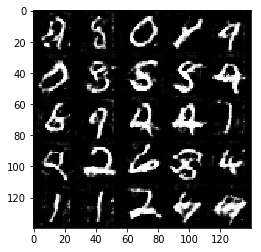

epoch=0 batch=2100 d_loss=1.14176 g_loss=1.04608


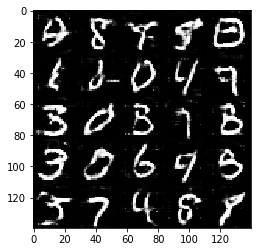

epoch=0 batch=2200 d_loss=1.13979 g_loss=1.04446


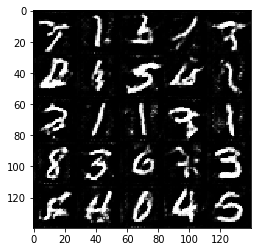

epoch=0 batch=2300 d_loss=1.13954 g_loss=1.03622


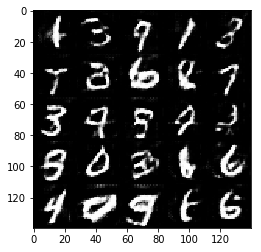

epoch=0 batch=2400 d_loss=1.13918 g_loss=1.02899


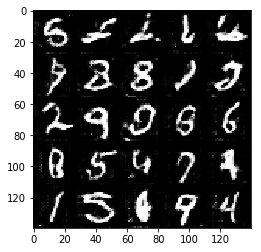

epoch=0 batch=2500 d_loss=1.14049 g_loss=1.02086


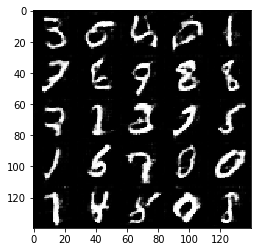

epoch=0 batch=2600 d_loss=1.13809 g_loss=1.0207


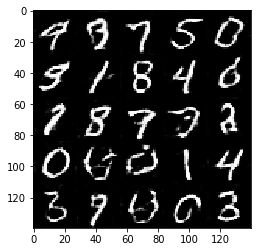

epoch=0 batch=2700 d_loss=1.13638 g_loss=1.01774


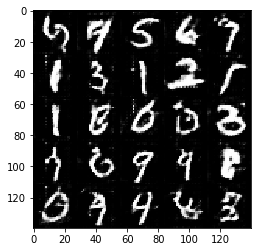

epoch=0 batch=2800 d_loss=1.13814 g_loss=1.01139


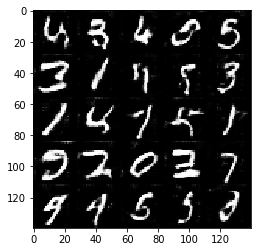

epoch=0 batch=2900 d_loss=1.14092 g_loss=1.00408


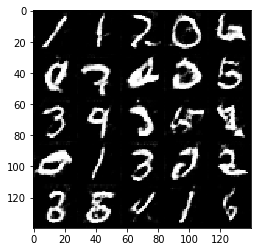

epoch=0 batch=3000 d_loss=1.14079 g_loss=1.00054


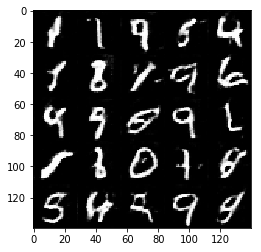

epoch=0 batch=3100 d_loss=1.14207 g_loss=0.99468


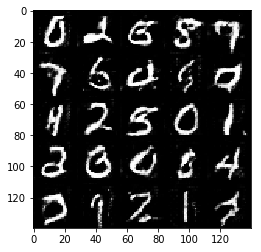

epoch=0 batch=3200 d_loss=1.14019 g_loss=0.991923


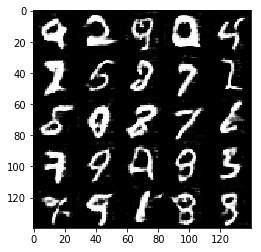

epoch=0 batch=3300 d_loss=1.14159 g_loss=0.987261


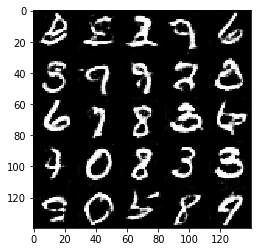

epoch=0 batch=3400 d_loss=1.14079 g_loss=0.984431


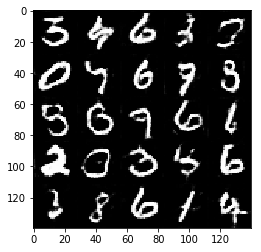

epoch=0 batch=3500 d_loss=1.1393 g_loss=0.982115


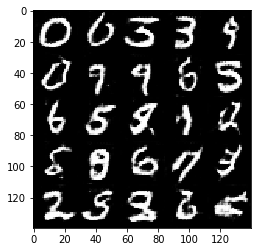

epoch=0 batch=3600 d_loss=1.13777 g_loss=0.981402


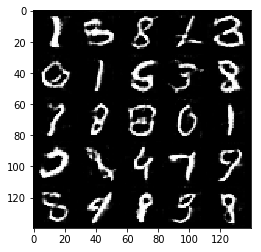

epoch=0 batch=3700 d_loss=1.13751 g_loss=0.978605


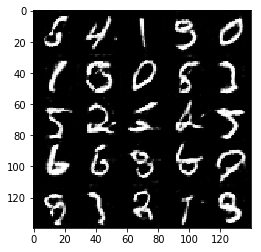

epoch=1 batch=0 d_loss=1.4626 g_loss=0.549969


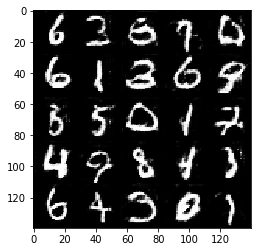

epoch=1 batch=100 d_loss=1.20522 g_loss=0.818344


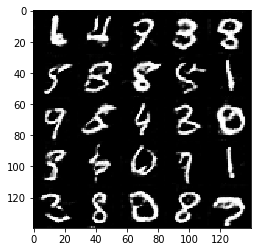

epoch=1 batch=200 d_loss=1.16313 g_loss=0.826441


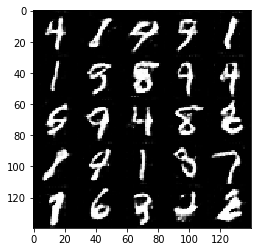

epoch=1 batch=300 d_loss=1.14089 g_loss=0.85141


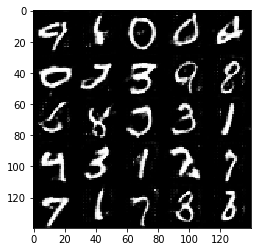

epoch=1 batch=400 d_loss=1.13852 g_loss=0.855939


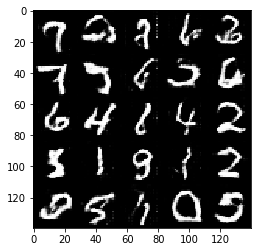

epoch=1 batch=500 d_loss=1.13571 g_loss=0.853438


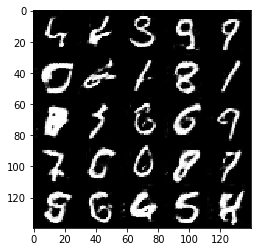

epoch=1 batch=600 d_loss=1.1232 g_loss=0.877834


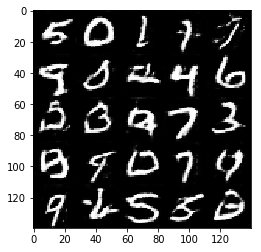

epoch=1 batch=700 d_loss=1.11137 g_loss=0.8876


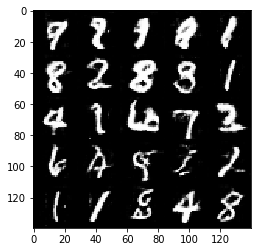

epoch=1 batch=800 d_loss=1.108 g_loss=0.889051


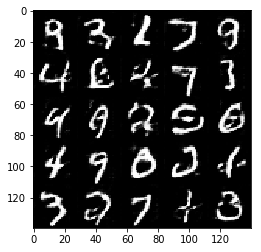

epoch=1 batch=900 d_loss=1.10879 g_loss=0.88167


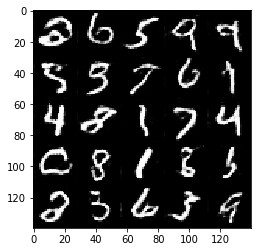

epoch=1 batch=1000 d_loss=1.10713 g_loss=0.881908


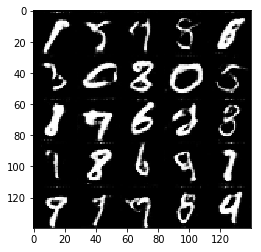

epoch=1 batch=1100 d_loss=1.10653 g_loss=0.880529


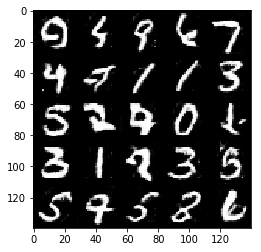

epoch=1 batch=1200 d_loss=1.10535 g_loss=0.883279


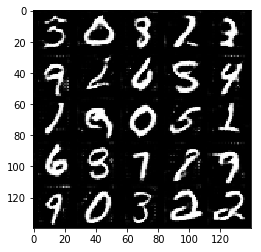

epoch=1 batch=1300 d_loss=1.10686 g_loss=0.888174


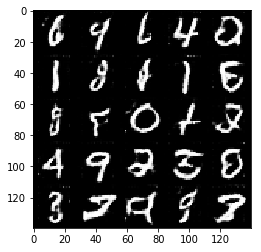

epoch=1 batch=1400 d_loss=1.10249 g_loss=0.893584


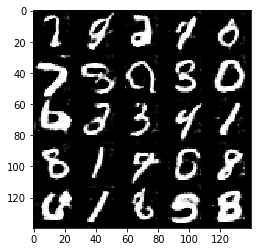

epoch=1 batch=1500 d_loss=1.10454 g_loss=0.889572


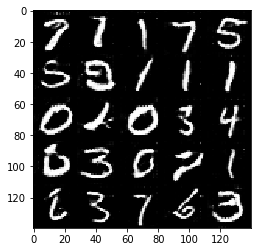

epoch=1 batch=1600 d_loss=1.10133 g_loss=0.895677


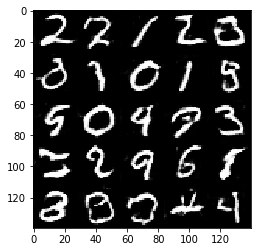

epoch=1 batch=1700 d_loss=1.104 g_loss=0.896372


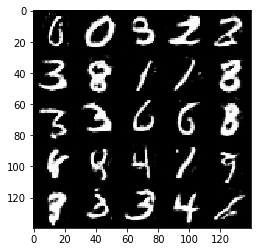

epoch=1 batch=1800 d_loss=1.10056 g_loss=0.89865


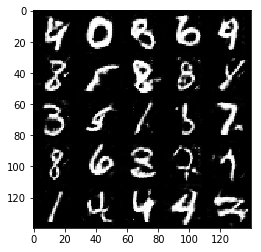

epoch=1 batch=1900 d_loss=1.09821 g_loss=0.903344


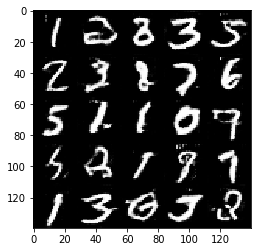

epoch=1 batch=2000 d_loss=1.09177 g_loss=0.911819


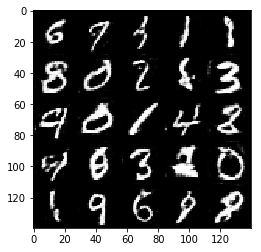

epoch=1 batch=2100 d_loss=1.09018 g_loss=0.918733


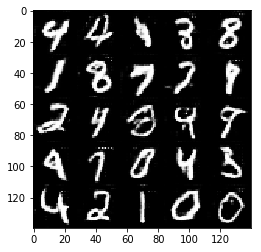

epoch=1 batch=2200 d_loss=1.08765 g_loss=0.922282


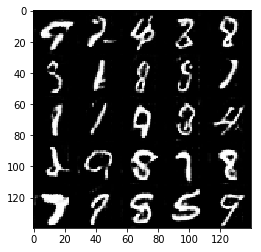

epoch=1 batch=2300 d_loss=1.0837 g_loss=0.924461


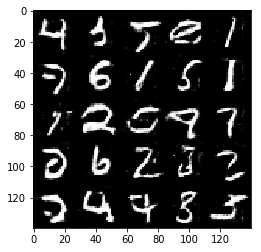

epoch=1 batch=2400 d_loss=1.08047 g_loss=0.927937


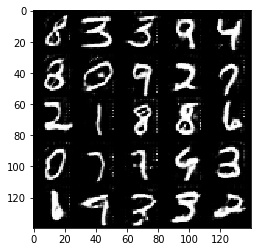

epoch=1 batch=2500 d_loss=1.0771 g_loss=0.93359


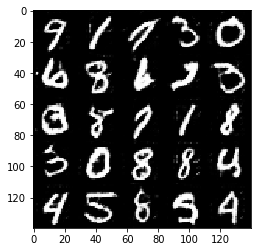

epoch=1 batch=2600 d_loss=1.07536 g_loss=0.934174


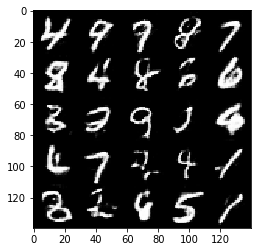

epoch=1 batch=2700 d_loss=1.07613 g_loss=0.938388


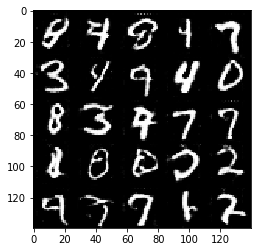

epoch=1 batch=2800 d_loss=1.07516 g_loss=0.938386


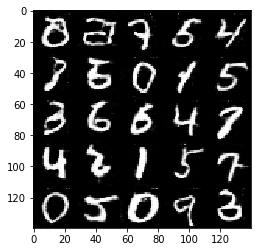

epoch=1 batch=2900 d_loss=1.07552 g_loss=0.939071


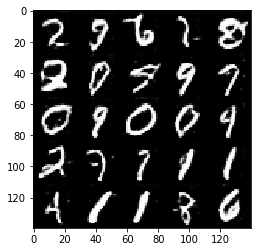

epoch=1 batch=3000 d_loss=1.07344 g_loss=0.943404


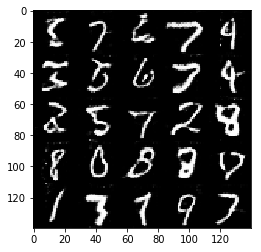

epoch=1 batch=3100 d_loss=1.07022 g_loss=0.946133


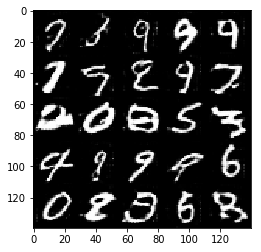

epoch=1 batch=3200 d_loss=1.06995 g_loss=0.94669


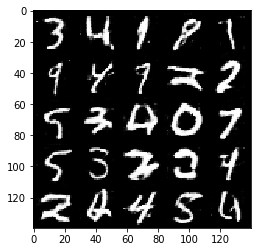

epoch=1 batch=3300 d_loss=1.06769 g_loss=0.949197


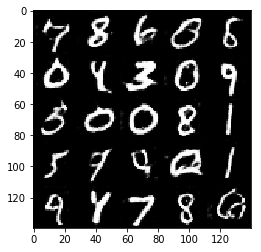

epoch=1 batch=3400 d_loss=1.06509 g_loss=0.951892


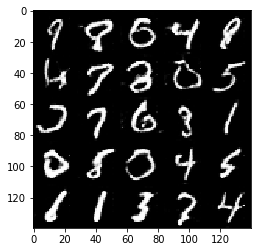

epoch=1 batch=3500 d_loss=1.06252 g_loss=0.95472


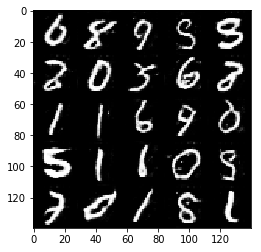

epoch=1 batch=3600 d_loss=1.05945 g_loss=0.960615


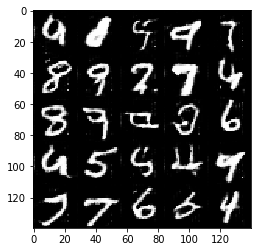

epoch=1 batch=3700 d_loss=1.05691 g_loss=0.964098
Finished


In [21]:
batch_size = 16
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

(202599, 28, 28, 3)


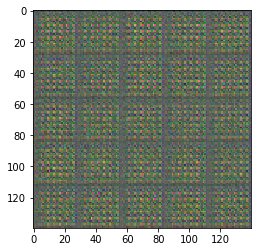

epoch=0 batch=0 d_loss=3.99087 g_loss=0.779043


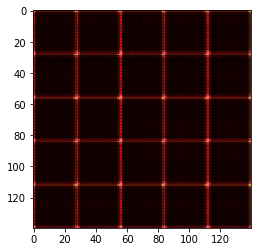

epoch=0 batch=100 d_loss=1.16986 g_loss=4.6522


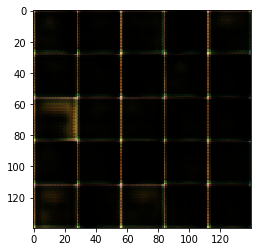

epoch=0 batch=200 d_loss=1.04563 g_loss=3.95471


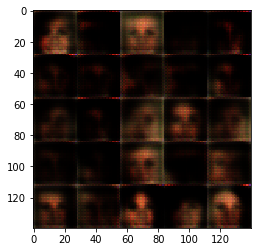

epoch=0 batch=300 d_loss=1.12841 g_loss=3.13186


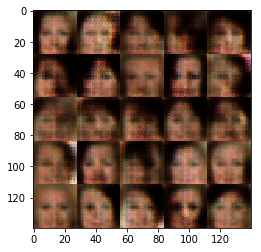

epoch=0 batch=400 d_loss=1.17983 g_loss=2.67815


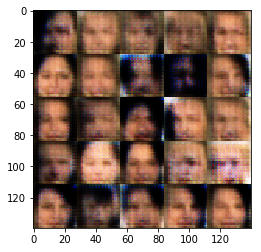

epoch=0 batch=500 d_loss=1.20242 g_loss=2.39824


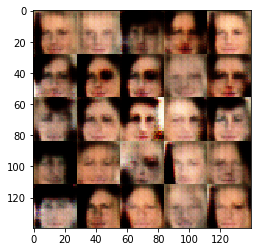

epoch=0 batch=600 d_loss=1.21457 g_loss=2.20981


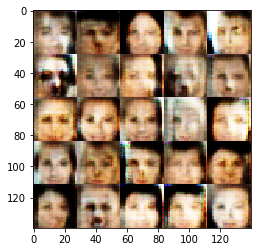

epoch=0 batch=700 d_loss=1.21777 g_loss=2.07102


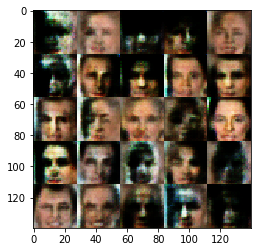

epoch=0 batch=800 d_loss=1.22344 g_loss=1.958


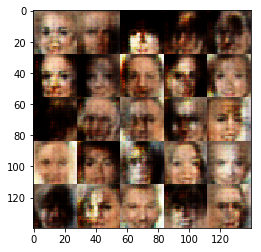

epoch=0 batch=900 d_loss=1.22961 g_loss=1.87092


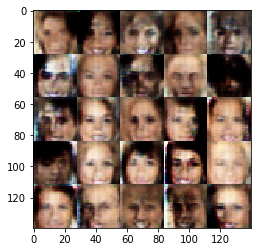

epoch=0 batch=1000 d_loss=1.2287 g_loss=1.79839


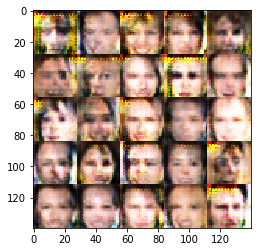

epoch=0 batch=1100 d_loss=1.21837 g_loss=1.75501


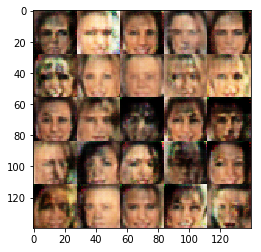

epoch=0 batch=1200 d_loss=1.21782 g_loss=1.70764


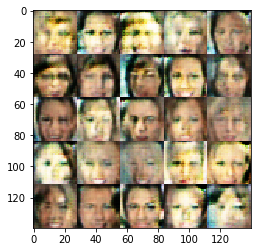

epoch=0 batch=1300 d_loss=1.2169 g_loss=1.67143


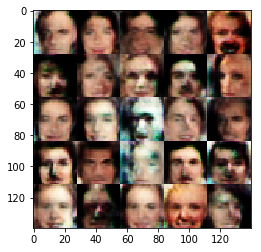

epoch=0 batch=1400 d_loss=1.21616 g_loss=1.62825


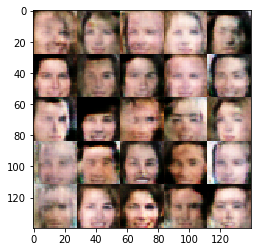

epoch=0 batch=1500 d_loss=1.21541 g_loss=1.59029


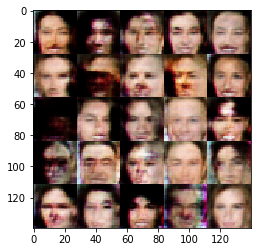

epoch=0 batch=1600 d_loss=1.21708 g_loss=1.55469


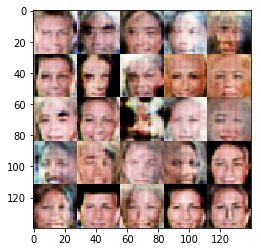

epoch=0 batch=1700 d_loss=1.21866 g_loss=1.52559


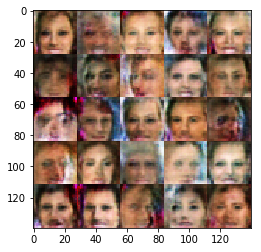

epoch=0 batch=1800 d_loss=1.21765 g_loss=1.49824


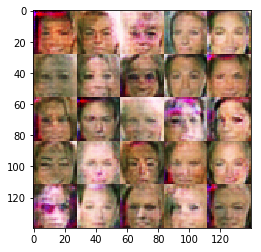

epoch=0 batch=1900 d_loss=1.21991 g_loss=1.47004


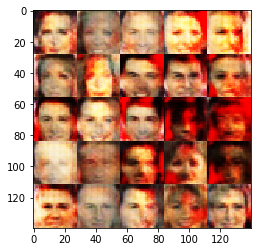

epoch=0 batch=2000 d_loss=1.21976 g_loss=1.44856


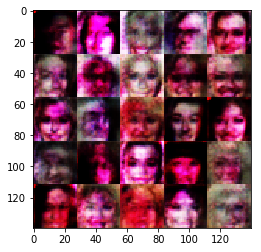

epoch=0 batch=2100 d_loss=1.21801 g_loss=1.42865


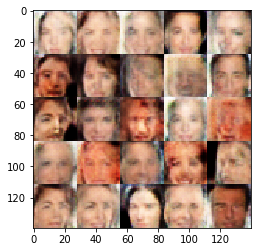

epoch=0 batch=2200 d_loss=1.22166 g_loss=1.40912


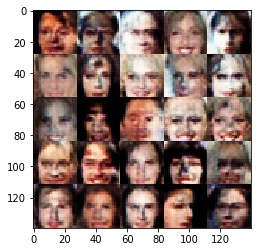

epoch=0 batch=2300 d_loss=1.22205 g_loss=1.38993


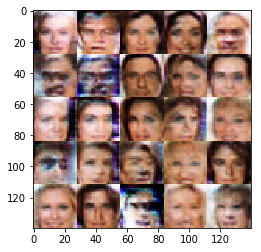

epoch=0 batch=2400 d_loss=1.22416 g_loss=1.37445


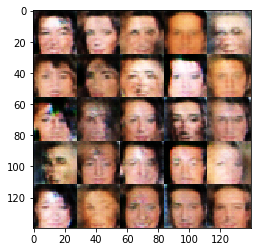

epoch=0 batch=2500 d_loss=1.22282 g_loss=1.36499


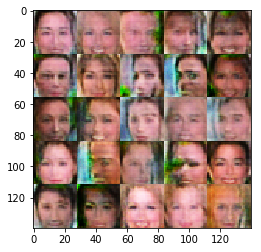

epoch=0 batch=2600 d_loss=1.22176 g_loss=1.35071


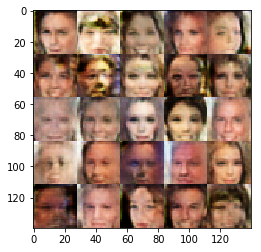

epoch=0 batch=2700 d_loss=1.22312 g_loss=1.33741


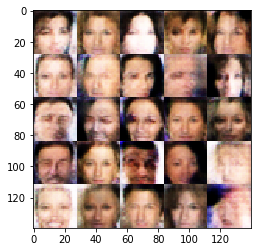

epoch=0 batch=2800 d_loss=1.22459 g_loss=1.32199


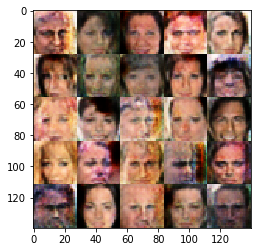

epoch=0 batch=2900 d_loss=1.22624 g_loss=1.30853


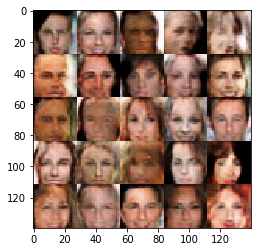

epoch=0 batch=3000 d_loss=1.2261 g_loss=1.29624


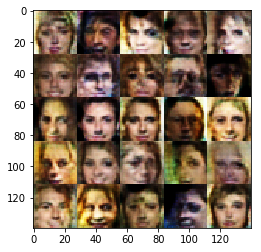

epoch=0 batch=3100 d_loss=1.22607 g_loss=1.28448


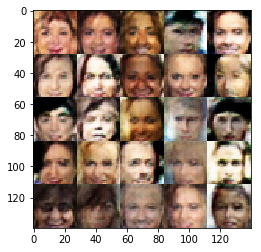

epoch=0 batch=3200 d_loss=1.22584 g_loss=1.27367


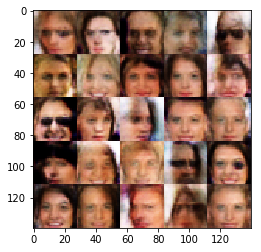

epoch=0 batch=3300 d_loss=1.22494 g_loss=1.26394


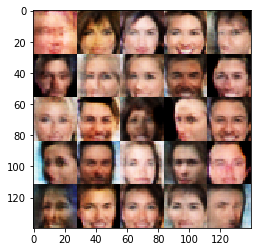

epoch=0 batch=3400 d_loss=1.22489 g_loss=1.25474


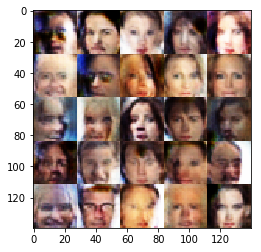

epoch=0 batch=3500 d_loss=1.22573 g_loss=1.24495


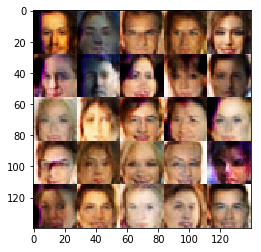

epoch=0 batch=3600 d_loss=1.22514 g_loss=1.23717


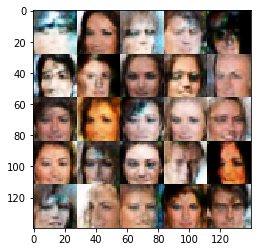

epoch=0 batch=3700 d_loss=1.22536 g_loss=1.2289


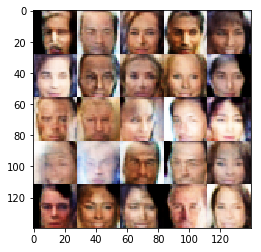

epoch=0 batch=3800 d_loss=1.22377 g_loss=1.22959


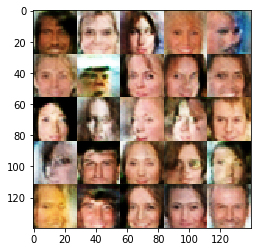

epoch=0 batch=3900 d_loss=1.22242 g_loss=1.22439


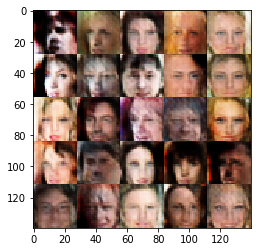

epoch=0 batch=4000 d_loss=1.22053 g_loss=1.22082


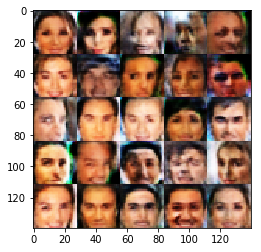

epoch=0 batch=4100 d_loss=1.21916 g_loss=1.2154


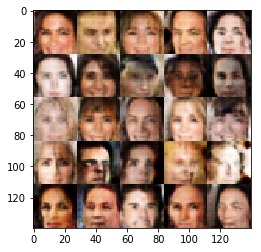

epoch=0 batch=4200 d_loss=1.21662 g_loss=1.21108


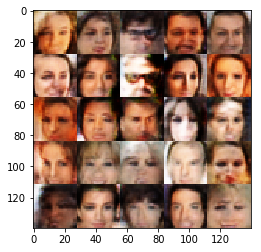

epoch=0 batch=4300 d_loss=1.21534 g_loss=1.20579


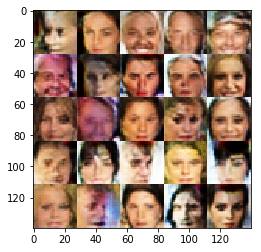

epoch=0 batch=4400 d_loss=1.2137 g_loss=1.20163


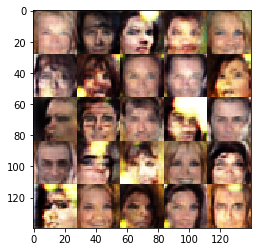

epoch=0 batch=4500 d_loss=1.21079 g_loss=1.19924


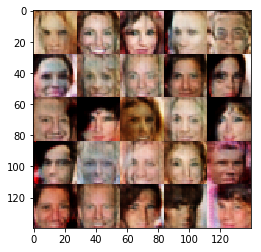

epoch=0 batch=4600 d_loss=1.20675 g_loss=1.20291


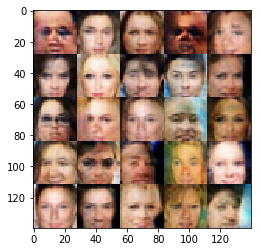

epoch=0 batch=4700 d_loss=1.20476 g_loss=1.20119


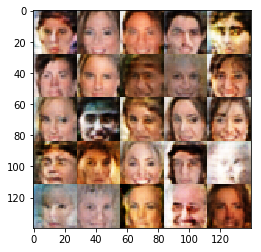

epoch=0 batch=4800 d_loss=1.20409 g_loss=1.19688


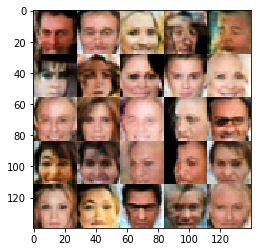

epoch=0 batch=4900 d_loss=1.20283 g_loss=1.19498


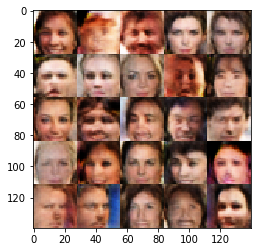

epoch=0 batch=5000 d_loss=1.20225 g_loss=1.19088


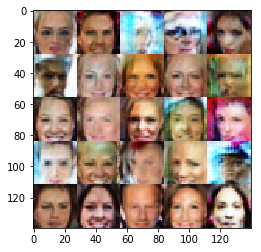

epoch=0 batch=5100 d_loss=1.20096 g_loss=1.18857


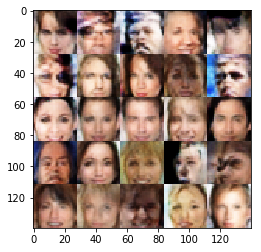

epoch=0 batch=5200 d_loss=1.1992 g_loss=1.18503


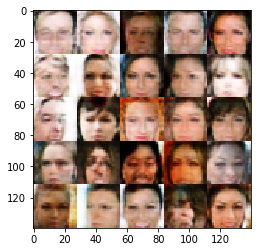

epoch=0 batch=5300 d_loss=1.19793 g_loss=1.18096


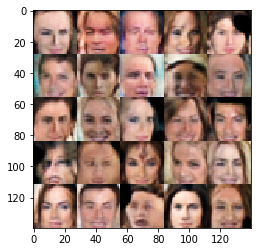

epoch=0 batch=5400 d_loss=1.19676 g_loss=1.17833


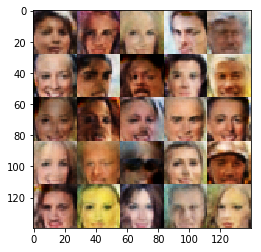

epoch=0 batch=5500 d_loss=1.19456 g_loss=1.17583


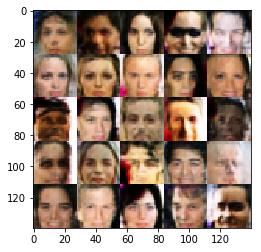

epoch=0 batch=5600 d_loss=1.19333 g_loss=1.17329


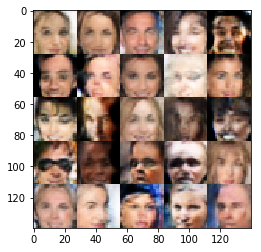

epoch=0 batch=5700 d_loss=1.19178 g_loss=1.17121


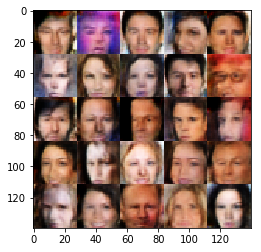

epoch=0 batch=5800 d_loss=1.18984 g_loss=1.16921


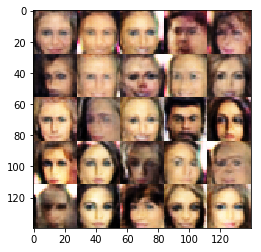

epoch=0 batch=5900 d_loss=1.18619 g_loss=1.17212


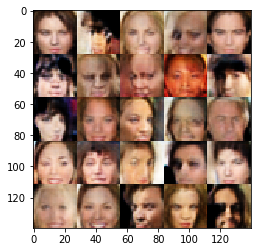

epoch=0 batch=6000 d_loss=1.18343 g_loss=1.1745


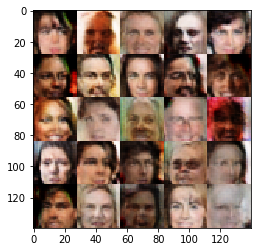

epoch=0 batch=6100 d_loss=1.18147 g_loss=1.17336


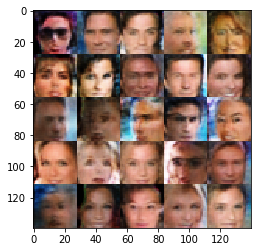

epoch=0 batch=6200 d_loss=1.178 g_loss=1.17647


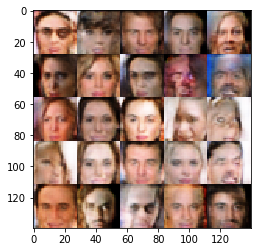

epoch=0 batch=6300 d_loss=1.17693 g_loss=1.17588


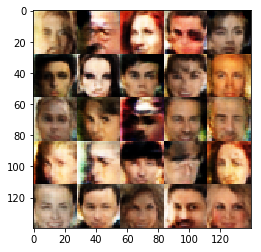

epoch=1 batch=0 d_loss=0.950123 g_loss=1.53787


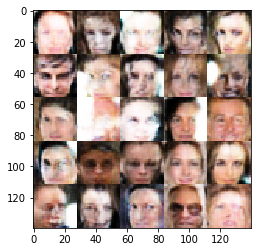

epoch=1 batch=100 d_loss=1.01703 g_loss=1.26686


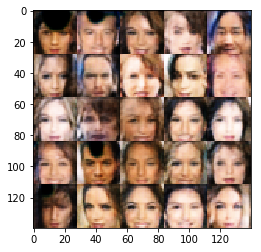

epoch=1 batch=200 d_loss=0.907294 g_loss=1.68854


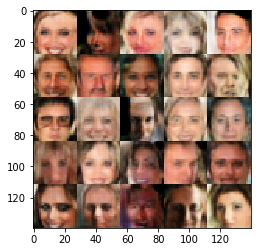

epoch=1 batch=300 d_loss=0.944013 g_loss=1.50938


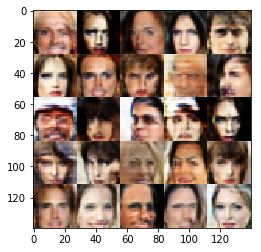

epoch=1 batch=400 d_loss=0.968377 g_loss=1.40731


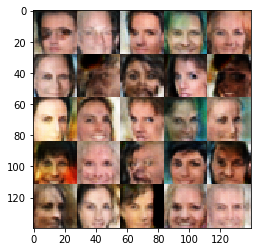

epoch=1 batch=500 d_loss=0.983146 g_loss=1.34285


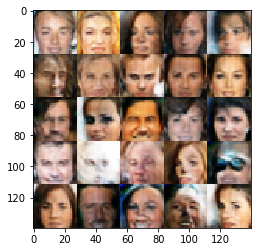

epoch=1 batch=600 d_loss=1.00147 g_loss=1.29509


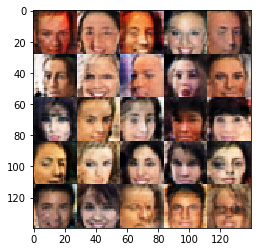

epoch=1 batch=700 d_loss=1.00994 g_loss=1.26351


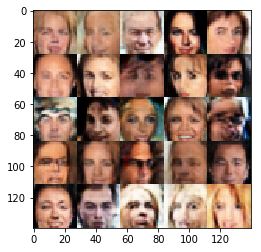

epoch=1 batch=800 d_loss=1.01585 g_loss=1.25872


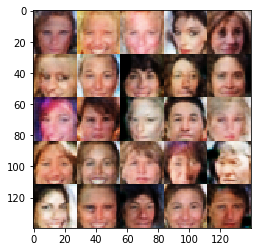

epoch=1 batch=900 d_loss=1.02266 g_loss=1.23921


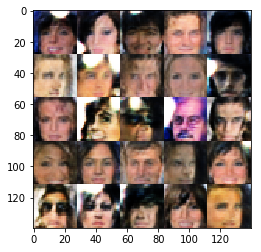

epoch=1 batch=1000 d_loss=1.02511 g_loss=1.23696


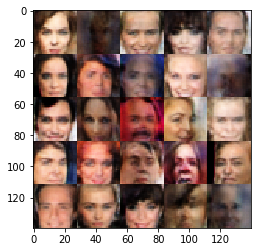

epoch=1 batch=1100 d_loss=1.0188 g_loss=1.25806


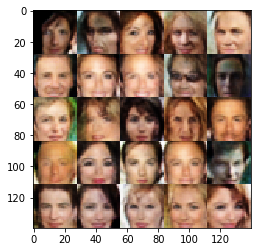

epoch=1 batch=1200 d_loss=1.02107 g_loss=1.25048


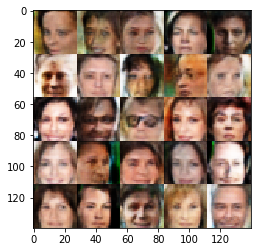

epoch=1 batch=1300 d_loss=1.02569 g_loss=1.23646


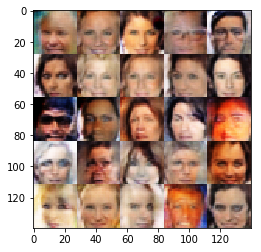

epoch=1 batch=1400 d_loss=1.02921 g_loss=1.23045


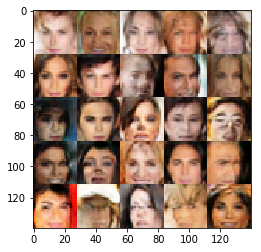

epoch=1 batch=1500 d_loss=1.02602 g_loss=1.22296


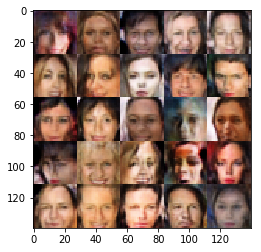

epoch=1 batch=1600 d_loss=1.02668 g_loss=1.21853


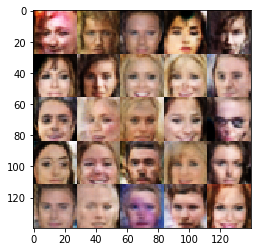

epoch=1 batch=1700 d_loss=1.03021 g_loss=1.21136


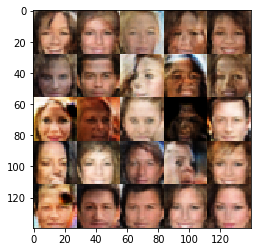

epoch=1 batch=1800 d_loss=1.027 g_loss=1.2167


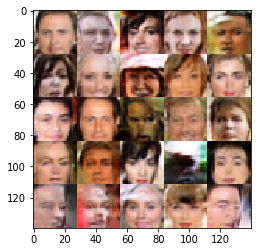

epoch=1 batch=1900 d_loss=1.02705 g_loss=1.20936


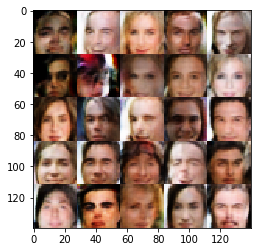

epoch=1 batch=2000 d_loss=1.02634 g_loss=1.2084


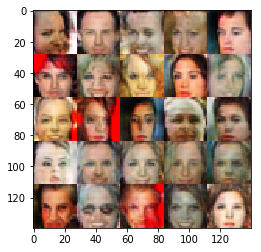

epoch=1 batch=2100 d_loss=1.02594 g_loss=1.22322


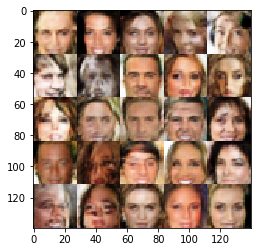

epoch=1 batch=2200 d_loss=1.02184 g_loss=1.22713


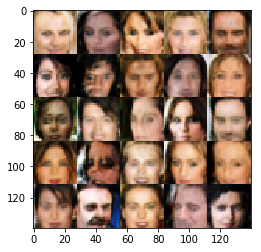

epoch=1 batch=2300 d_loss=1.02094 g_loss=1.22683


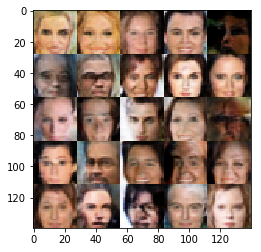

epoch=1 batch=2400 d_loss=1.01435 g_loss=1.24768


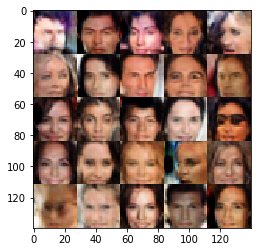

epoch=1 batch=2500 d_loss=1.01345 g_loss=1.24816


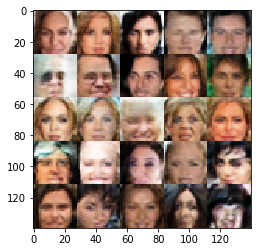

epoch=1 batch=2600 d_loss=1.01073 g_loss=1.24875


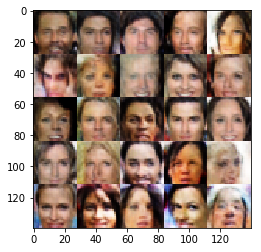

epoch=1 batch=2700 d_loss=1.01213 g_loss=1.24576


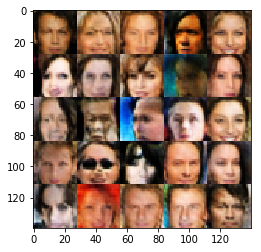

epoch=1 batch=2800 d_loss=1.01003 g_loss=1.24655


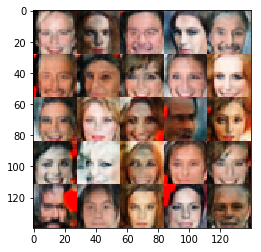

epoch=1 batch=2900 d_loss=1.00822 g_loss=1.246


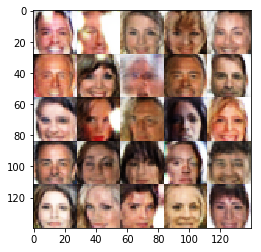

epoch=1 batch=3000 d_loss=1.00342 g_loss=1.25973


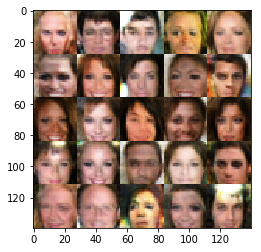

epoch=1 batch=3100 d_loss=0.996883 g_loss=1.27827


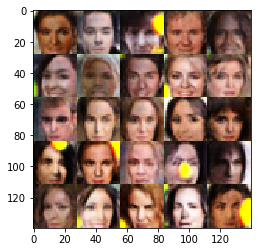

epoch=1 batch=3200 d_loss=0.990668 g_loss=1.29633


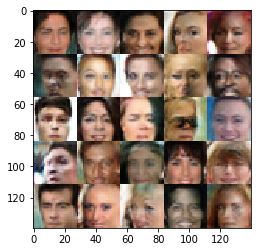

epoch=1 batch=3300 d_loss=0.987613 g_loss=1.30108


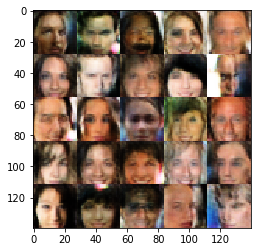

epoch=1 batch=3400 d_loss=0.980306 g_loss=1.31798


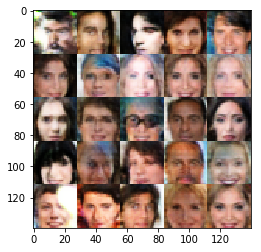

epoch=1 batch=3500 d_loss=0.974741 g_loss=1.32779


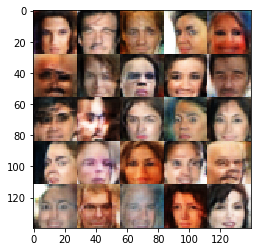

epoch=1 batch=3600 d_loss=0.97093 g_loss=1.33485


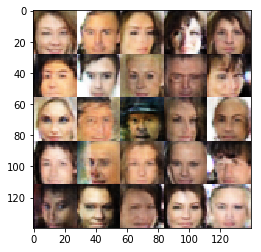

epoch=1 batch=3700 d_loss=0.966157 g_loss=1.34612


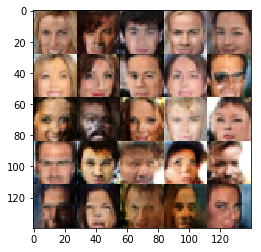

epoch=1 batch=3800 d_loss=0.96207 g_loss=1.35282


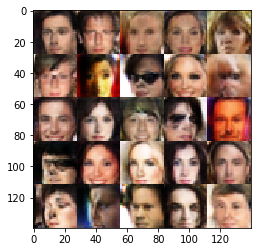

epoch=1 batch=3900 d_loss=0.959421 g_loss=1.35697


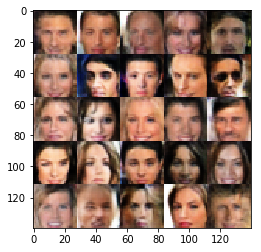

epoch=1 batch=4000 d_loss=0.956306 g_loss=1.36124


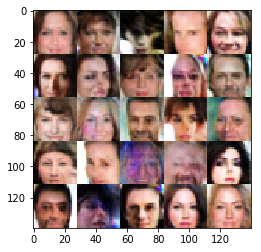

epoch=1 batch=4100 d_loss=0.953911 g_loss=1.36326


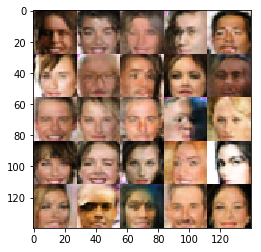

epoch=1 batch=4200 d_loss=0.950508 g_loss=1.37375


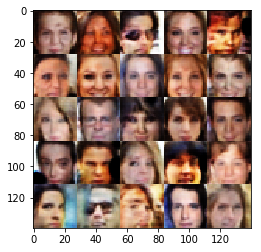

epoch=1 batch=4300 d_loss=0.947284 g_loss=1.38708


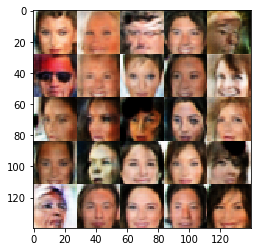

epoch=1 batch=4400 d_loss=0.945695 g_loss=1.38845


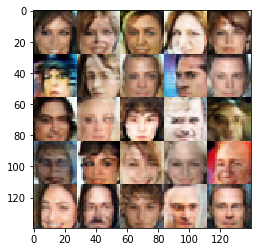

epoch=1 batch=4500 d_loss=0.944635 g_loss=1.38925


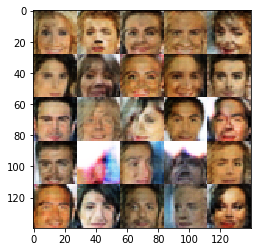

epoch=1 batch=4600 d_loss=0.940748 g_loss=1.40073


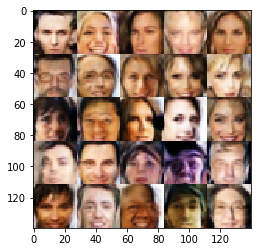

epoch=1 batch=4700 d_loss=0.937786 g_loss=1.40914


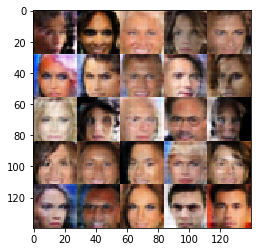

epoch=1 batch=4800 d_loss=0.937737 g_loss=1.40825


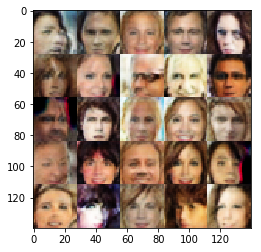

epoch=1 batch=4900 d_loss=0.936588 g_loss=1.40726


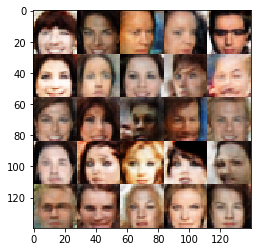

epoch=1 batch=5000 d_loss=0.936369 g_loss=1.40504


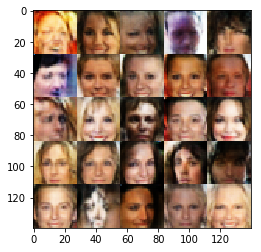

epoch=1 batch=5100 d_loss=0.937127 g_loss=1.40448


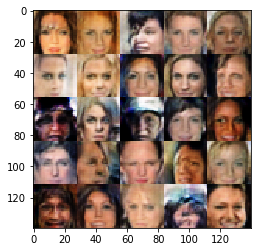

epoch=1 batch=5200 d_loss=0.937915 g_loss=1.40195


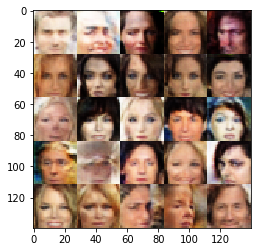

epoch=1 batch=5300 d_loss=0.937503 g_loss=1.40115


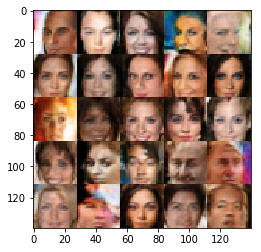

epoch=1 batch=5400 d_loss=0.938054 g_loss=1.39946


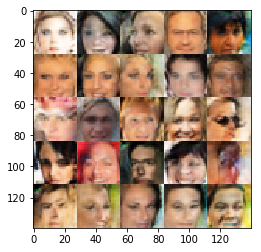

epoch=1 batch=5500 d_loss=0.937646 g_loss=1.39962


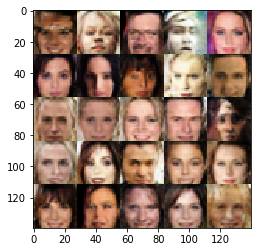

epoch=1 batch=5600 d_loss=0.937262 g_loss=1.40051


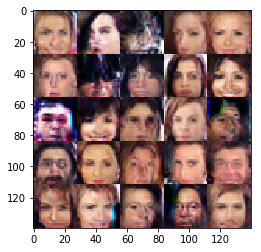

epoch=1 batch=5700 d_loss=0.930986 g_loss=1.42443


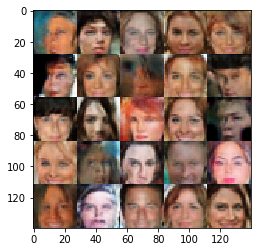

epoch=1 batch=5800 d_loss=0.928533 g_loss=1.42775


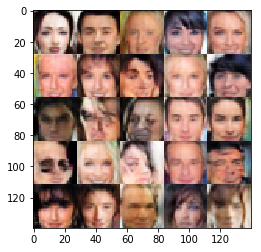

epoch=1 batch=5900 d_loss=0.927655 g_loss=1.4287


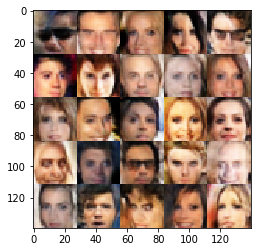

epoch=1 batch=6000 d_loss=0.927973 g_loss=1.42698


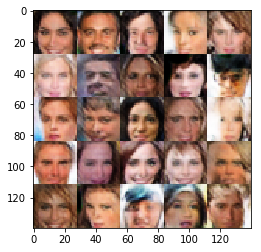

epoch=1 batch=6100 d_loss=0.927473 g_loss=1.42734


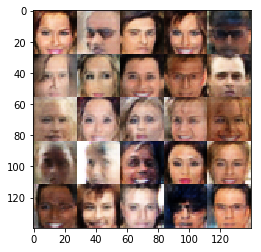

epoch=1 batch=6200 d_loss=0.926474 g_loss=1.43242


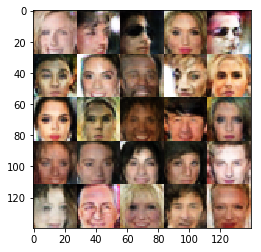

epoch=1 batch=6300 d_loss=0.923402 g_loss=1.43743


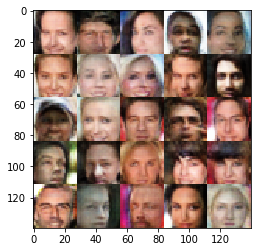

epoch=2 batch=0 d_loss=1.93892 g_loss=0.297112


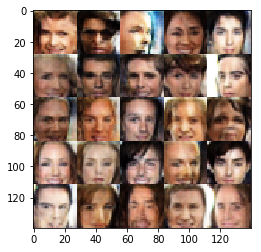

epoch=2 batch=100 d_loss=0.623029 g_loss=2.43022


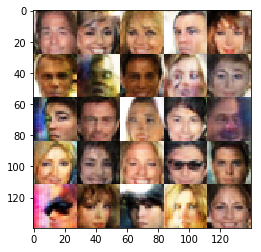

epoch=2 batch=200 d_loss=0.64772 g_loss=2.33643


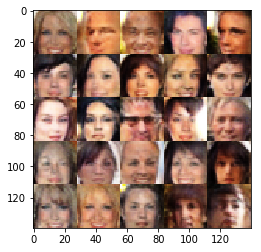

epoch=2 batch=300 d_loss=0.656673 g_loss=2.19495


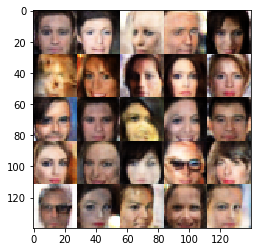

epoch=2 batch=400 d_loss=0.667612 g_loss=2.13209


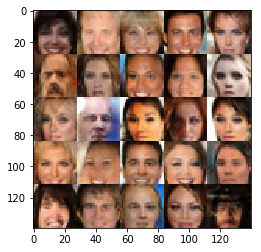

epoch=2 batch=500 d_loss=0.681362 g_loss=2.04597


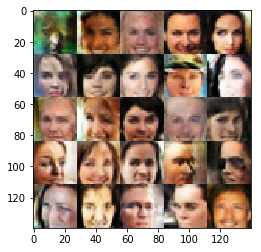

epoch=2 batch=600 d_loss=0.687474 g_loss=1.98725


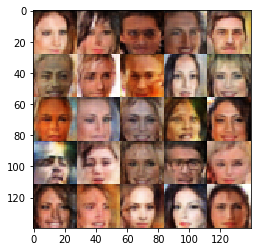

epoch=2 batch=700 d_loss=0.700729 g_loss=1.94912


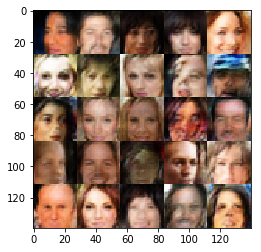

epoch=2 batch=800 d_loss=0.709347 g_loss=1.92299


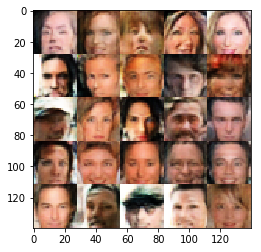

epoch=2 batch=900 d_loss=0.716751 g_loss=1.90137


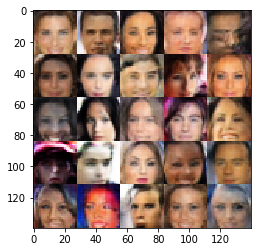

epoch=2 batch=1000 d_loss=0.723885 g_loss=1.88954


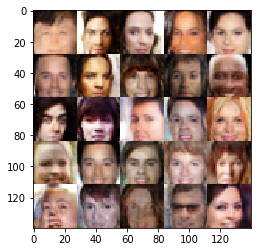

epoch=2 batch=1100 d_loss=0.728504 g_loss=1.86219


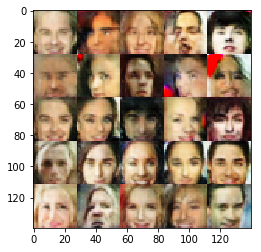

epoch=2 batch=1200 d_loss=0.730048 g_loss=1.86578


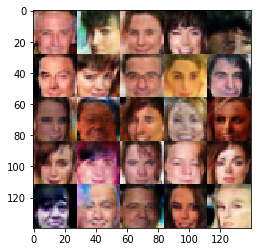

epoch=2 batch=1300 d_loss=0.736323 g_loss=1.84728


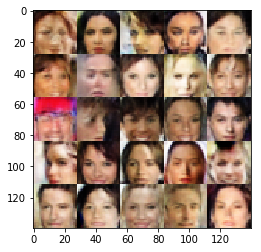

epoch=2 batch=1400 d_loss=0.741988 g_loss=1.82664


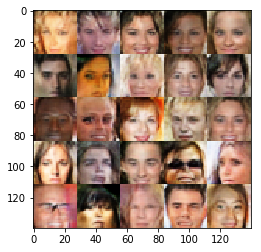

epoch=2 batch=1500 d_loss=0.750879 g_loss=1.81127


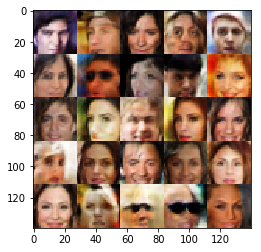

epoch=2 batch=1600 d_loss=0.759161 g_loss=1.7948


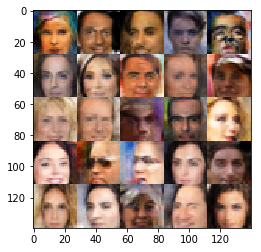

epoch=2 batch=1700 d_loss=0.76769 g_loss=1.77972


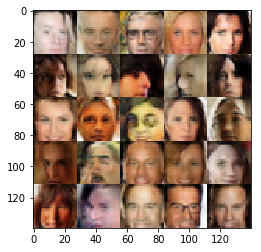

epoch=2 batch=1800 d_loss=0.771065 g_loss=1.76784


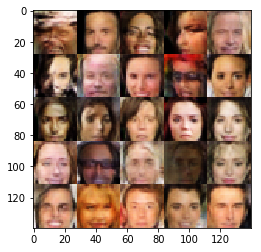

epoch=2 batch=1900 d_loss=0.776241 g_loss=1.76181


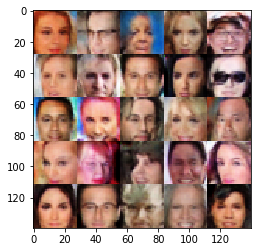

epoch=2 batch=2000 d_loss=0.782794 g_loss=1.74901


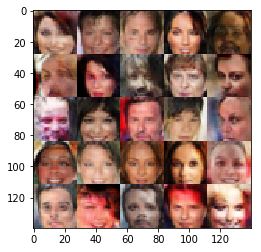

epoch=2 batch=2100 d_loss=0.785976 g_loss=1.73531


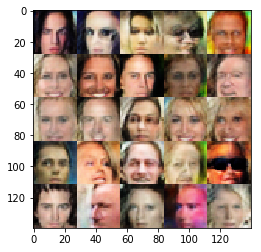

epoch=2 batch=2200 d_loss=0.791318 g_loss=1.72242


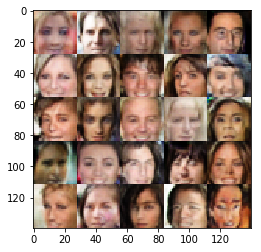

epoch=2 batch=2300 d_loss=0.793316 g_loss=1.71468


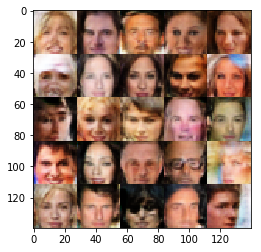

epoch=2 batch=2400 d_loss=0.798111 g_loss=1.70652


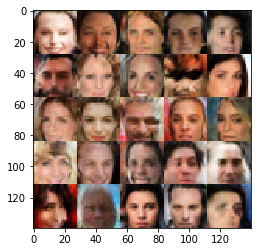

epoch=2 batch=2500 d_loss=0.799032 g_loss=1.70123


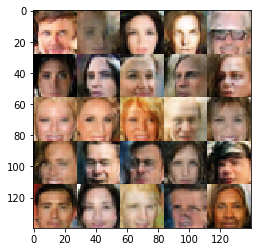

epoch=2 batch=2600 d_loss=0.80117 g_loss=1.69456


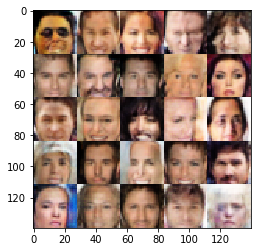

epoch=2 batch=2700 d_loss=0.80502 g_loss=1.68547


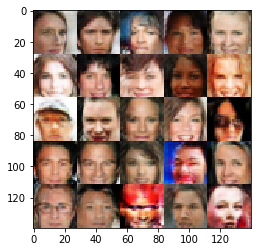

epoch=2 batch=2800 d_loss=0.805277 g_loss=1.68073


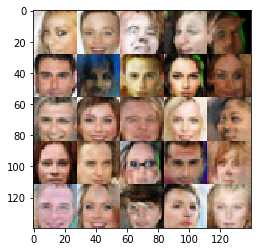

epoch=2 batch=2900 d_loss=0.808168 g_loss=1.67644


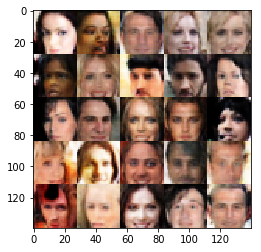

epoch=2 batch=3000 d_loss=0.809111 g_loss=1.6723


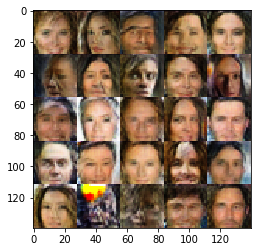

epoch=2 batch=3100 d_loss=0.801995 g_loss=1.71338


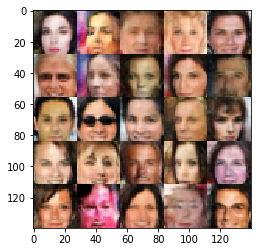

epoch=2 batch=3200 d_loss=0.798987 g_loss=1.72751


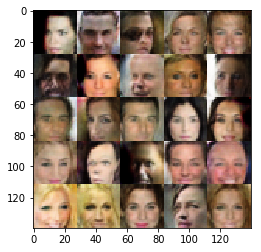

epoch=2 batch=3300 d_loss=0.800119 g_loss=1.72735


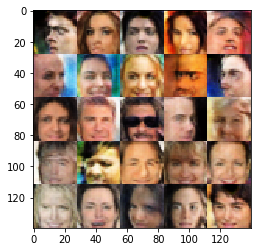

epoch=2 batch=3400 d_loss=0.801489 g_loss=1.72128


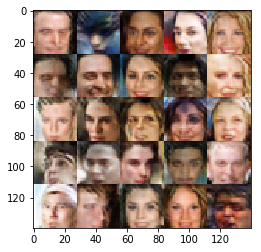

epoch=2 batch=3500 d_loss=0.803975 g_loss=1.71406


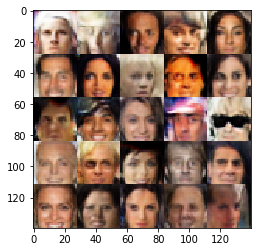

epoch=2 batch=3600 d_loss=0.8053 g_loss=1.70898


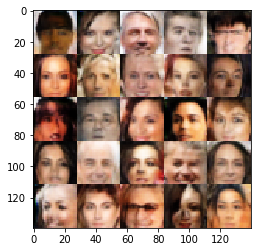

epoch=2 batch=3700 d_loss=0.810189 g_loss=1.70325


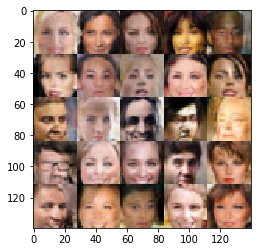

epoch=2 batch=3800 d_loss=0.811943 g_loss=1.69746


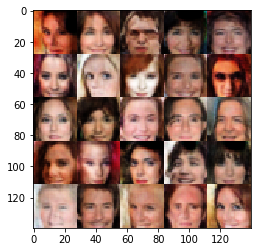

epoch=2 batch=3900 d_loss=0.814064 g_loss=1.69092


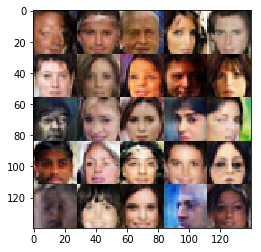

epoch=2 batch=4000 d_loss=0.816351 g_loss=1.68364


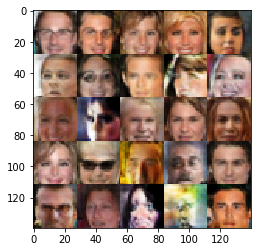

epoch=2 batch=4100 d_loss=0.817703 g_loss=1.67788


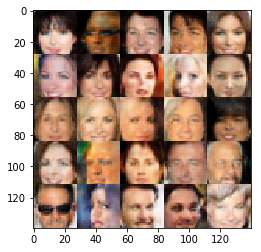

epoch=2 batch=4200 d_loss=0.818569 g_loss=1.67568


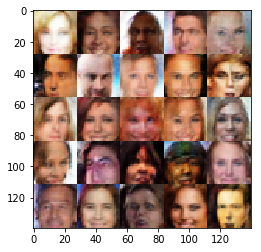

epoch=2 batch=4300 d_loss=0.819896 g_loss=1.67539


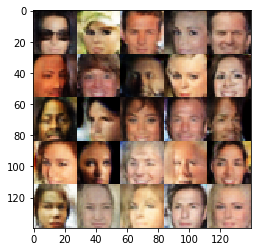

epoch=2 batch=4400 d_loss=0.822442 g_loss=1.66777


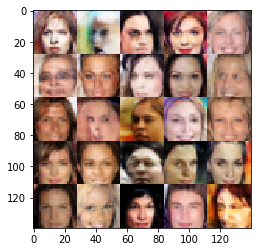

epoch=2 batch=4500 d_loss=0.821964 g_loss=1.66592


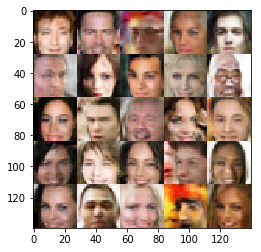

epoch=2 batch=4600 d_loss=0.822574 g_loss=1.66229


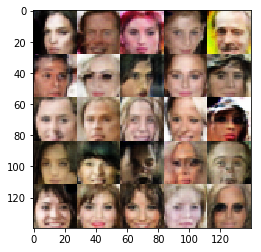

epoch=2 batch=4700 d_loss=0.823177 g_loss=1.6594


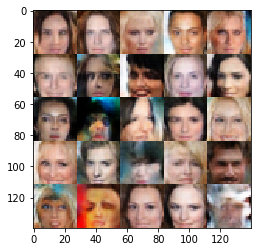

epoch=2 batch=4800 d_loss=0.825191 g_loss=1.65545


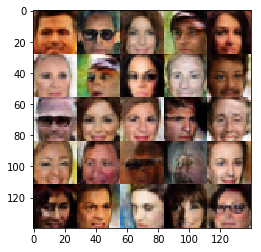

epoch=2 batch=4900 d_loss=0.824346 g_loss=1.65511


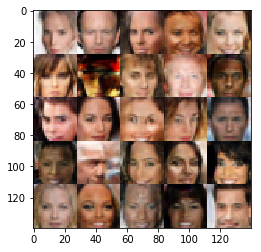

epoch=2 batch=5000 d_loss=0.824299 g_loss=1.65298


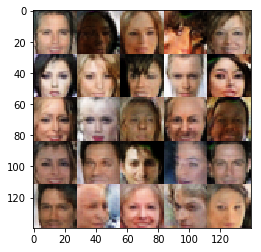

epoch=2 batch=5100 d_loss=0.82364 g_loss=1.65185


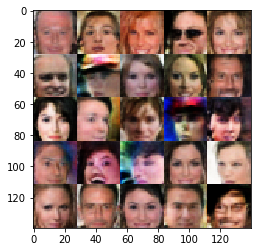

epoch=2 batch=5200 d_loss=0.824919 g_loss=1.64797


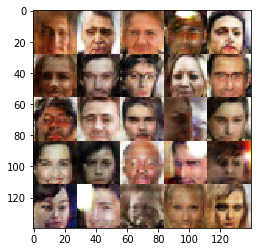

epoch=2 batch=5300 d_loss=0.823644 g_loss=1.65658


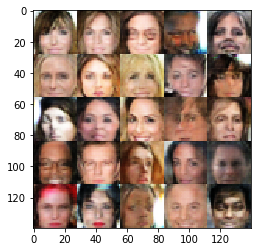

epoch=2 batch=5400 d_loss=0.821577 g_loss=1.66198


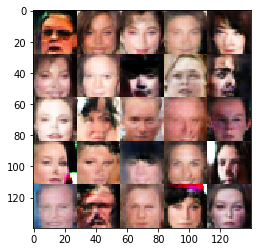

epoch=2 batch=5500 d_loss=0.819246 g_loss=1.67432


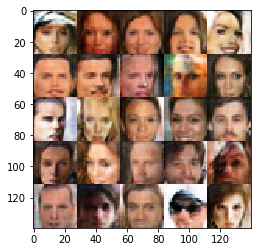

epoch=2 batch=5600 d_loss=0.815331 g_loss=1.69296


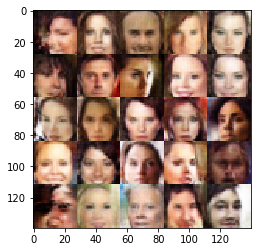

epoch=2 batch=5700 d_loss=0.811847 g_loss=1.70583


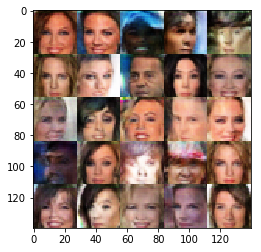

epoch=2 batch=5800 d_loss=0.810046 g_loss=1.7118


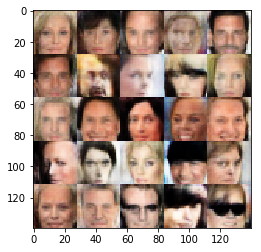

epoch=2 batch=5900 d_loss=0.808344 g_loss=1.71643


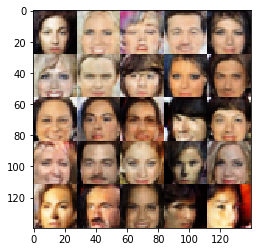

epoch=2 batch=6000 d_loss=0.806775 g_loss=1.71834


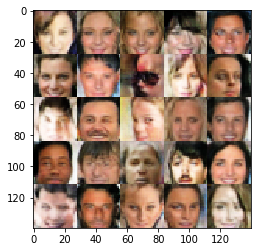

epoch=2 batch=6100 d_loss=0.806842 g_loss=1.71681


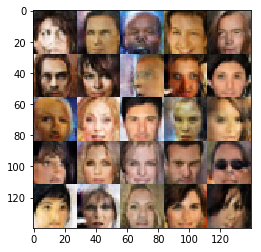

epoch=2 batch=6200 d_loss=0.807537 g_loss=1.71432


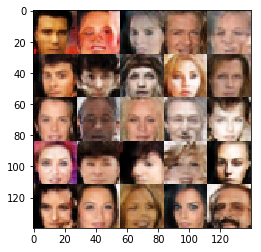

epoch=2 batch=6300 d_loss=0.809052 g_loss=1.71212


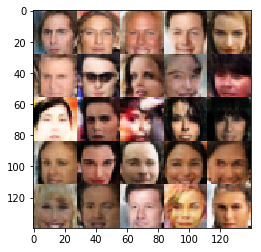

epoch=3 batch=0 d_loss=0.56985 g_loss=2.65947


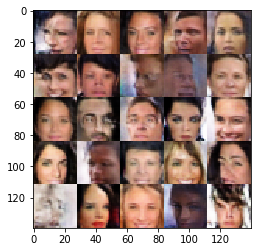

epoch=3 batch=100 d_loss=0.886195 g_loss=1.54238


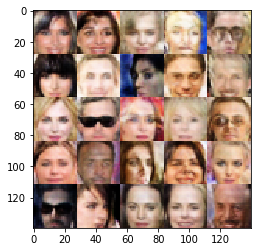

epoch=3 batch=200 d_loss=0.854831 g_loss=1.62062


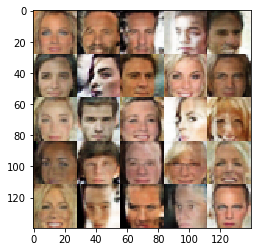

epoch=3 batch=300 d_loss=0.849818 g_loss=1.57852


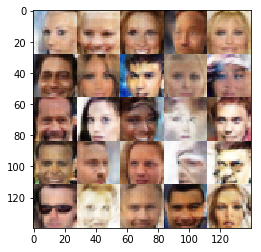

epoch=3 batch=400 d_loss=0.842627 g_loss=1.57123


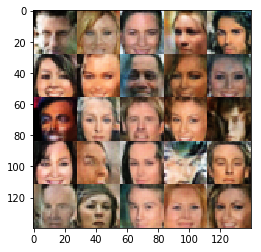

epoch=3 batch=500 d_loss=0.841896 g_loss=1.5575


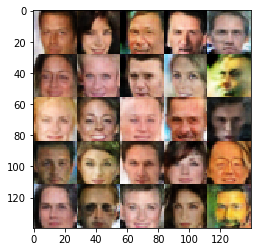

epoch=3 batch=600 d_loss=0.837028 g_loss=1.58313


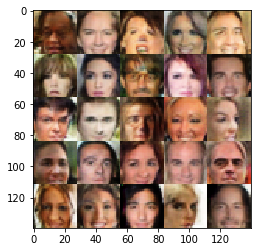

epoch=3 batch=700 d_loss=0.843605 g_loss=1.55987


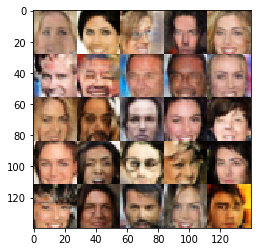

epoch=3 batch=800 d_loss=0.841369 g_loss=1.57218


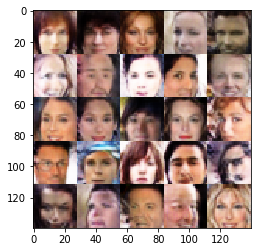

epoch=3 batch=900 d_loss=0.837915 g_loss=1.58136


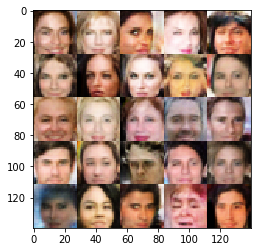

epoch=3 batch=1000 d_loss=0.833558 g_loss=1.60731


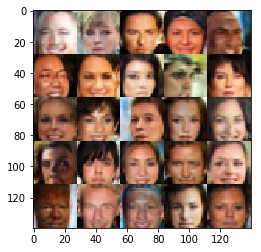

epoch=3 batch=1100 d_loss=0.838107 g_loss=1.59121


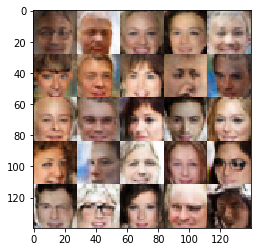

epoch=3 batch=1200 d_loss=0.837265 g_loss=1.58475


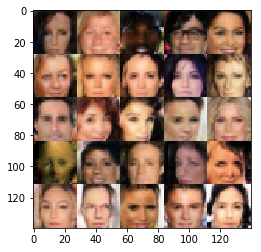

epoch=3 batch=1300 d_loss=0.834722 g_loss=1.59947


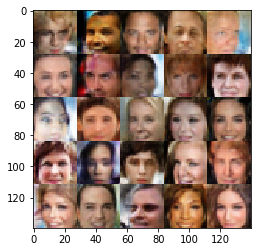

epoch=3 batch=1400 d_loss=0.840671 g_loss=1.5902


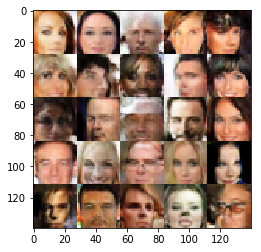

epoch=3 batch=1500 d_loss=0.841571 g_loss=1.57959


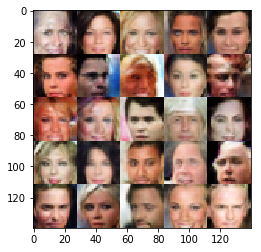

epoch=3 batch=1600 d_loss=0.843145 g_loss=1.58856


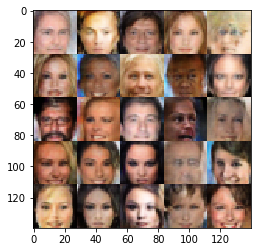

epoch=3 batch=1700 d_loss=0.841088 g_loss=1.59517


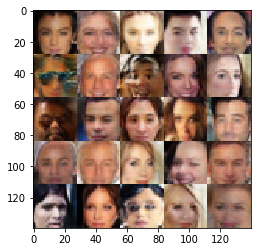

epoch=3 batch=1800 d_loss=0.844588 g_loss=1.58424


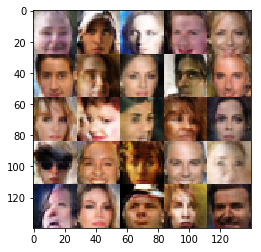

epoch=3 batch=1900 d_loss=0.843111 g_loss=1.58181


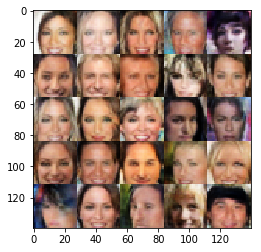

epoch=3 batch=2000 d_loss=0.844631 g_loss=1.5791


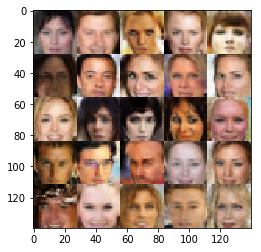

epoch=3 batch=2100 d_loss=0.846181 g_loss=1.57465


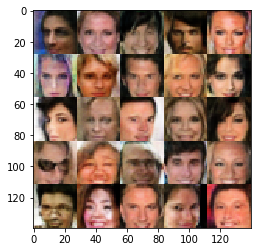

epoch=3 batch=2200 d_loss=0.844623 g_loss=1.57882


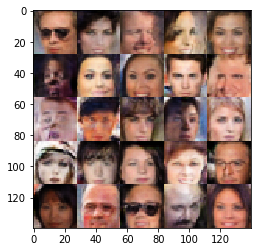

epoch=3 batch=2300 d_loss=0.844913 g_loss=1.57873


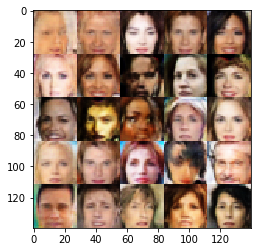

epoch=3 batch=2400 d_loss=0.843454 g_loss=1.5834


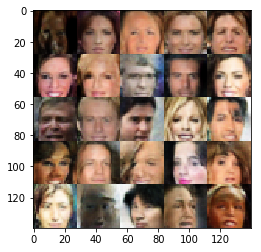

epoch=3 batch=2500 d_loss=0.843307 g_loss=1.58679


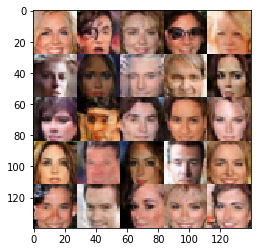

epoch=3 batch=2600 d_loss=0.845488 g_loss=1.58616


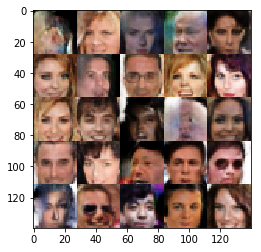

epoch=3 batch=2700 d_loss=0.847447 g_loss=1.5839


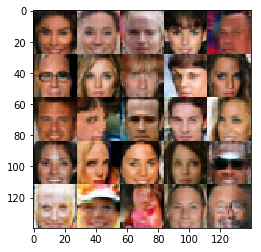

epoch=3 batch=2800 d_loss=0.846055 g_loss=1.58045


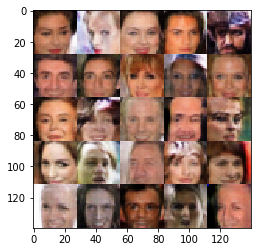

epoch=3 batch=2900 d_loss=0.84442 g_loss=1.58384


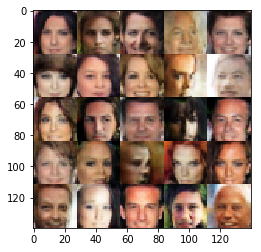

epoch=3 batch=3000 d_loss=0.844805 g_loss=1.58335


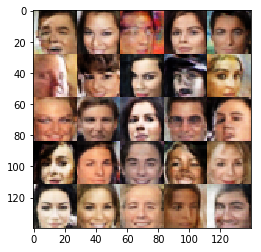

epoch=3 batch=3100 d_loss=0.845763 g_loss=1.58112


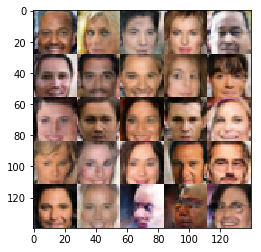

epoch=3 batch=3200 d_loss=0.844408 g_loss=1.57985


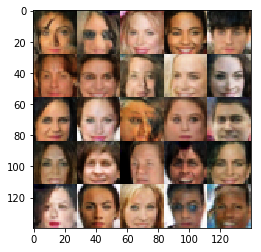

epoch=3 batch=3300 d_loss=0.842502 g_loss=1.58475


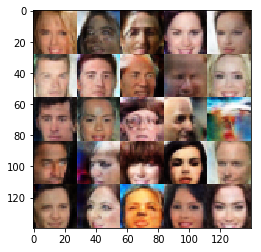

epoch=3 batch=3400 d_loss=0.84248 g_loss=1.58769


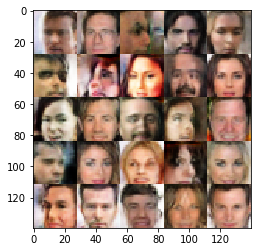

epoch=3 batch=3500 d_loss=0.842909 g_loss=1.58695


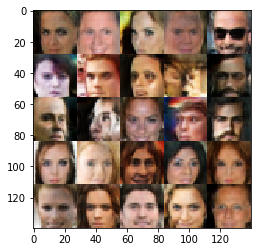

epoch=3 batch=3600 d_loss=0.842472 g_loss=1.59066


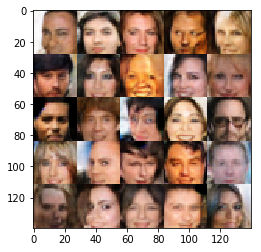

epoch=3 batch=3700 d_loss=0.841397 g_loss=1.59028


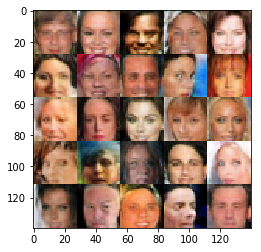

epoch=3 batch=3800 d_loss=0.841026 g_loss=1.59215


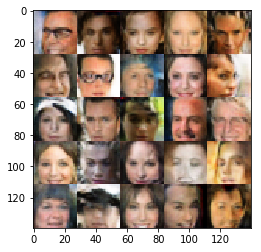

epoch=3 batch=3900 d_loss=0.841347 g_loss=1.59512


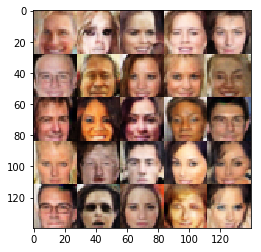

epoch=3 batch=4000 d_loss=0.840859 g_loss=1.592


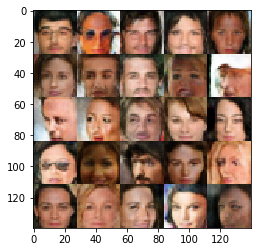

epoch=3 batch=4100 d_loss=0.840897 g_loss=1.58961


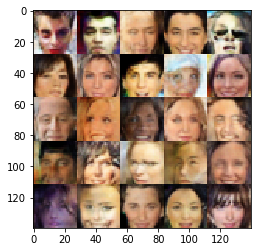

epoch=3 batch=4200 d_loss=0.840261 g_loss=1.59258


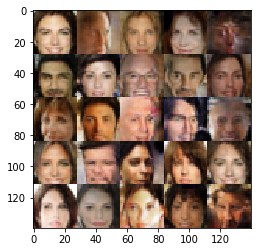

epoch=3 batch=4300 d_loss=0.83877 g_loss=1.59862


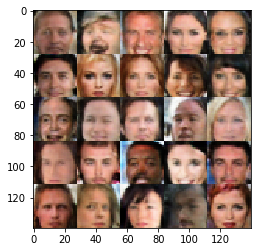

epoch=3 batch=4400 d_loss=0.83823 g_loss=1.606


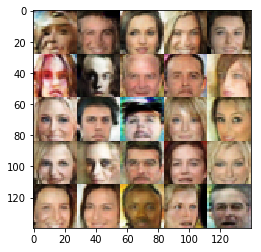

epoch=3 batch=4500 d_loss=0.83826 g_loss=1.606


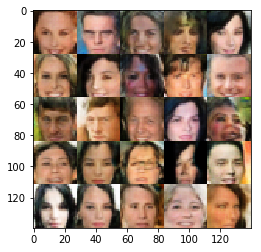

epoch=3 batch=4600 d_loss=0.838322 g_loss=1.60569


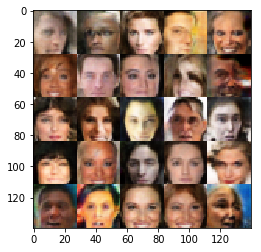

epoch=3 batch=4700 d_loss=0.838757 g_loss=1.60566


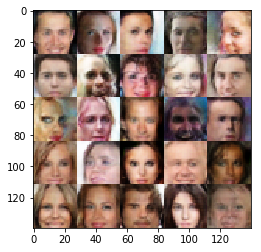

epoch=3 batch=4800 d_loss=0.838675 g_loss=1.60638


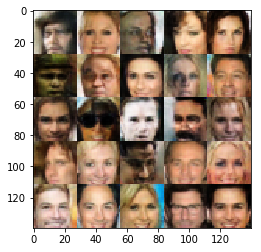

epoch=3 batch=4900 d_loss=0.837572 g_loss=1.60805


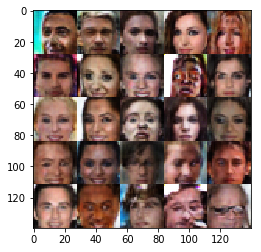

epoch=3 batch=5000 d_loss=0.836147 g_loss=1.61265


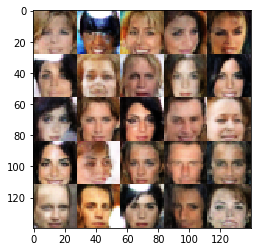

epoch=3 batch=5100 d_loss=0.834269 g_loss=1.62433


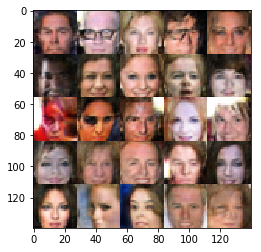

epoch=3 batch=5200 d_loss=0.831464 g_loss=1.63704


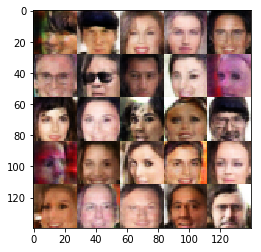

epoch=3 batch=5300 d_loss=0.828845 g_loss=1.6467


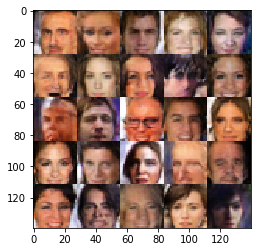

epoch=3 batch=5400 d_loss=0.825912 g_loss=1.65316


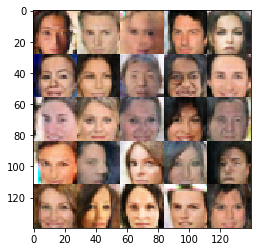

epoch=3 batch=5500 d_loss=0.824058 g_loss=1.65878


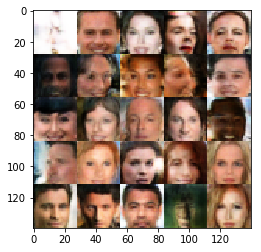

epoch=3 batch=5600 d_loss=0.820996 g_loss=1.67255


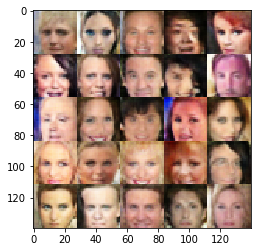

epoch=3 batch=5700 d_loss=0.820198 g_loss=1.6775


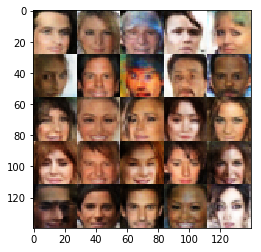

epoch=3 batch=5800 d_loss=0.817921 g_loss=1.68431


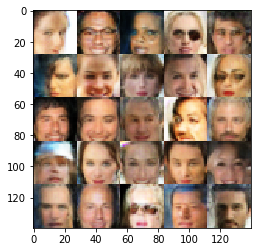

epoch=3 batch=5900 d_loss=0.816892 g_loss=1.68778


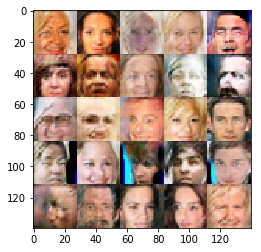

epoch=3 batch=6000 d_loss=0.813365 g_loss=1.69876


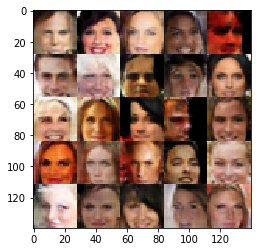

epoch=3 batch=6100 d_loss=0.811204 g_loss=1.7055


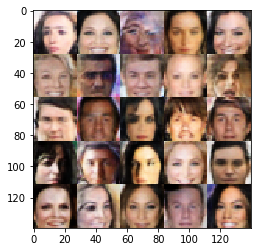

epoch=3 batch=6200 d_loss=0.810553 g_loss=1.70846


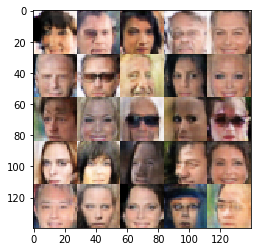

epoch=3 batch=6300 d_loss=0.810417 g_loss=1.71008


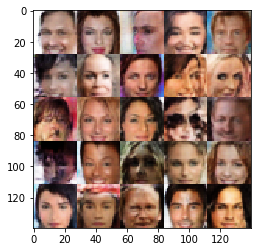

epoch=4 batch=0 d_loss=0.721771 g_loss=2.59499


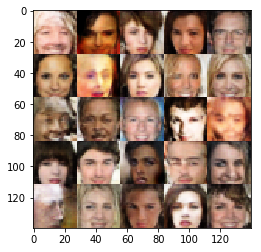

epoch=4 batch=100 d_loss=0.829095 g_loss=1.75361


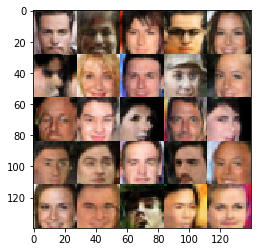

epoch=4 batch=200 d_loss=0.817879 g_loss=1.66223


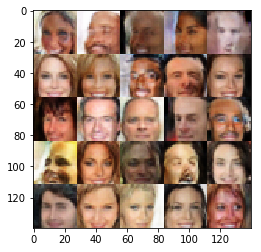

epoch=4 batch=300 d_loss=0.819875 g_loss=1.64638


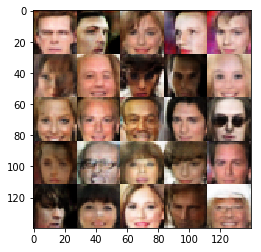

epoch=4 batch=400 d_loss=0.834382 g_loss=1.62008


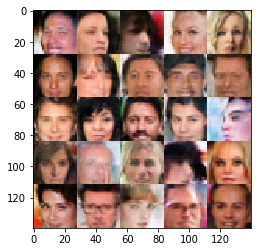

epoch=4 batch=500 d_loss=0.834722 g_loss=1.62657


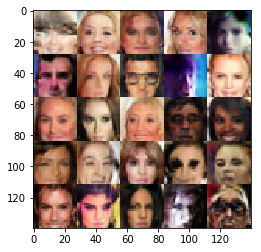

epoch=4 batch=600 d_loss=0.841679 g_loss=1.62597


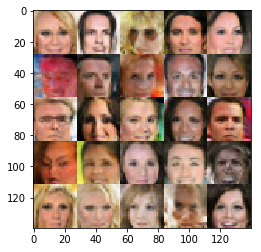

epoch=4 batch=700 d_loss=0.832029 g_loss=1.63662


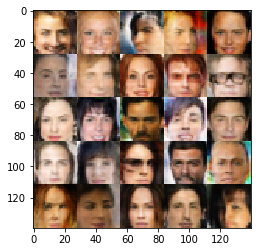

epoch=4 batch=800 d_loss=0.838433 g_loss=1.61942


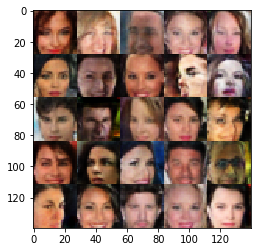

epoch=4 batch=900 d_loss=0.847 g_loss=1.62556


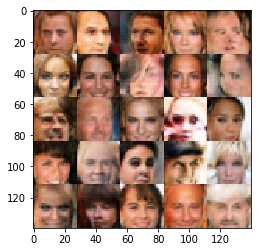

epoch=4 batch=1000 d_loss=0.849368 g_loss=1.61355


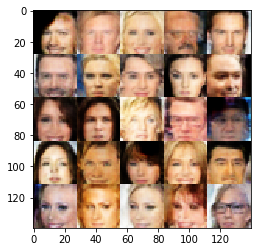

epoch=4 batch=1100 d_loss=0.834366 g_loss=1.70646


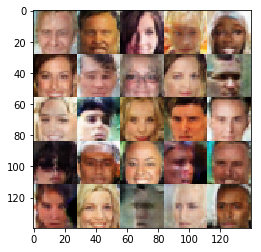

epoch=4 batch=1200 d_loss=0.82512 g_loss=1.71301


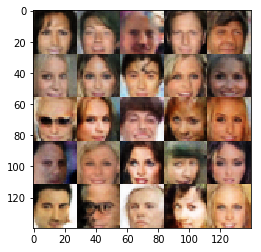

epoch=4 batch=1300 d_loss=0.825745 g_loss=1.71282


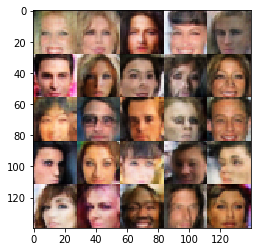

epoch=4 batch=1400 d_loss=0.824775 g_loss=1.71247


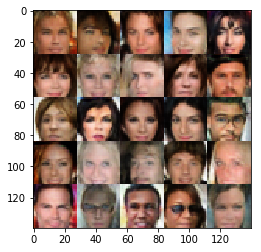

epoch=4 batch=1500 d_loss=0.826058 g_loss=1.70799


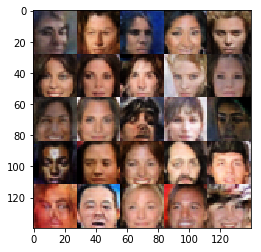

epoch=4 batch=1600 d_loss=0.827731 g_loss=1.70528


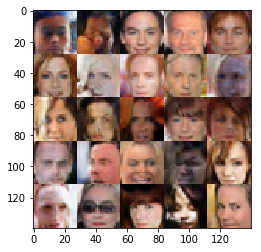

epoch=4 batch=1700 d_loss=0.829352 g_loss=1.69668


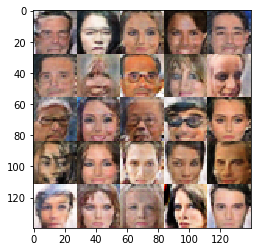

epoch=4 batch=1800 d_loss=0.820779 g_loss=1.74


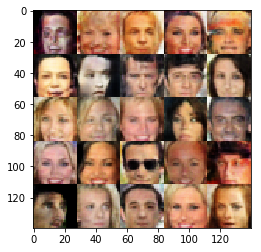

epoch=4 batch=1900 d_loss=0.816878 g_loss=1.77274


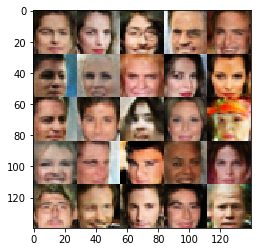

epoch=4 batch=2000 d_loss=0.816491 g_loss=1.77513


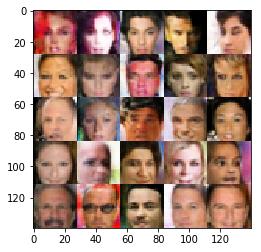

epoch=4 batch=2100 d_loss=0.81673 g_loss=1.76963


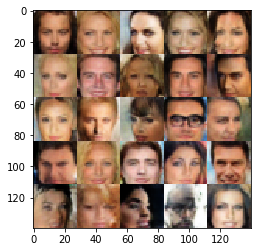

epoch=4 batch=2200 d_loss=0.816908 g_loss=1.76406


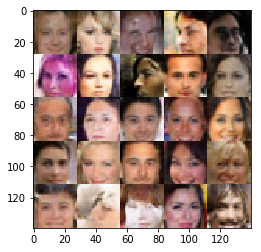

epoch=4 batch=2300 d_loss=0.815213 g_loss=1.7643


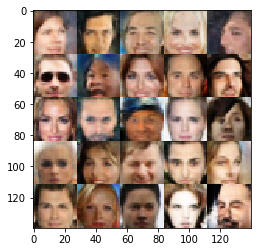

epoch=4 batch=2400 d_loss=0.814255 g_loss=1.76122


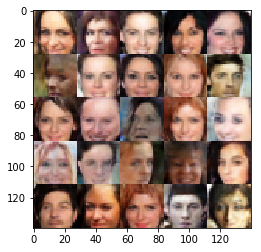

epoch=4 batch=2500 d_loss=0.814097 g_loss=1.75463


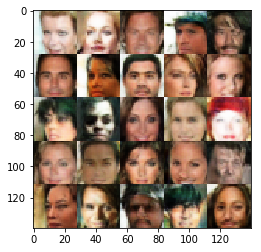

epoch=4 batch=2600 d_loss=0.815582 g_loss=1.7514


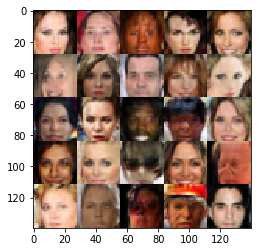

epoch=4 batch=2700 d_loss=0.81565 g_loss=1.74694


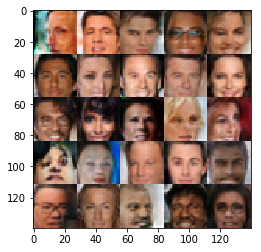

epoch=4 batch=2800 d_loss=0.817195 g_loss=1.74304


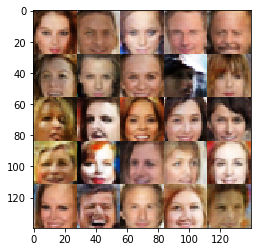

epoch=4 batch=2900 d_loss=0.817346 g_loss=1.73791


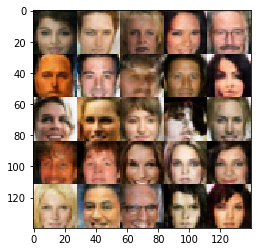

epoch=4 batch=3000 d_loss=0.819059 g_loss=1.73427


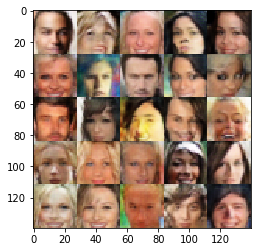

epoch=4 batch=3100 d_loss=0.823782 g_loss=1.72528


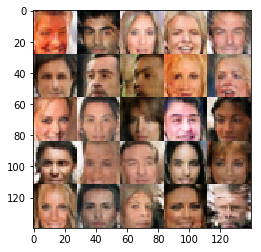

epoch=4 batch=3200 d_loss=0.823623 g_loss=1.72069


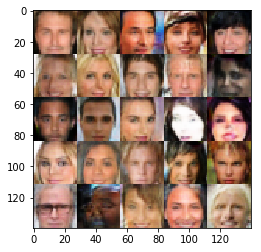

epoch=4 batch=3300 d_loss=0.824663 g_loss=1.71354


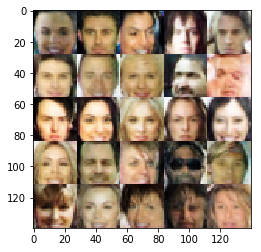

epoch=4 batch=3400 d_loss=0.825988 g_loss=1.7081


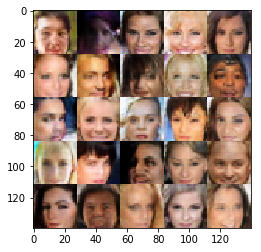

epoch=4 batch=3500 d_loss=0.824704 g_loss=1.7123


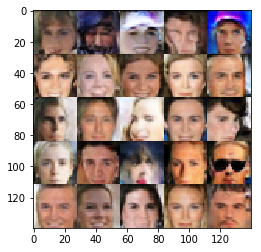

epoch=4 batch=3600 d_loss=0.824071 g_loss=1.71278


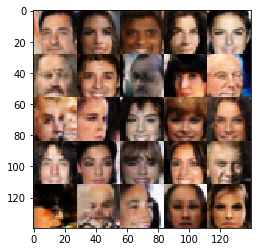

epoch=4 batch=3700 d_loss=0.824857 g_loss=1.71178


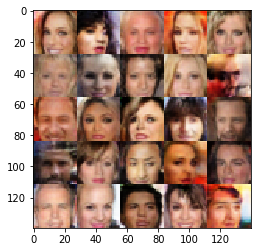

epoch=4 batch=3800 d_loss=0.825247 g_loss=1.71052


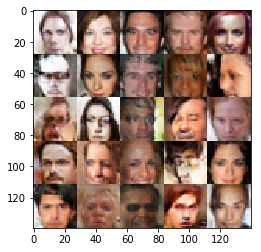

epoch=4 batch=3900 d_loss=0.824785 g_loss=1.71041


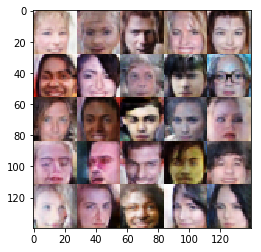

epoch=4 batch=4000 d_loss=0.825363 g_loss=1.7068


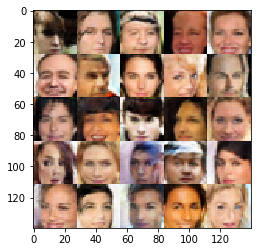

epoch=4 batch=4100 d_loss=0.823961 g_loss=1.70521


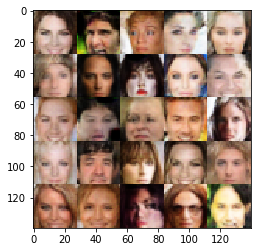

epoch=4 batch=4200 d_loss=0.822838 g_loss=1.70632


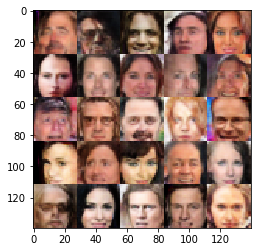

epoch=4 batch=4300 d_loss=0.822978 g_loss=1.7062


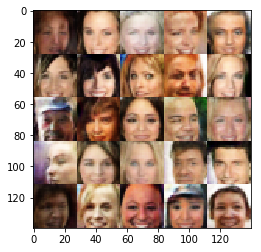

epoch=4 batch=4400 d_loss=0.823528 g_loss=1.70344


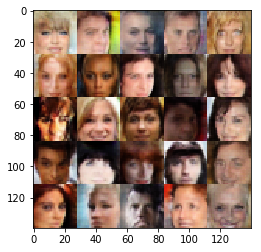

epoch=4 batch=4500 d_loss=0.823203 g_loss=1.70104


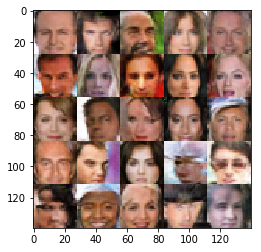

epoch=4 batch=4600 d_loss=0.824365 g_loss=1.69715


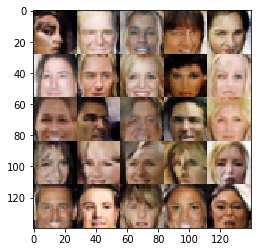

epoch=4 batch=4700 d_loss=0.823067 g_loss=1.69577


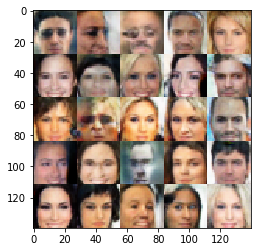

epoch=4 batch=4800 d_loss=0.822204 g_loss=1.69879


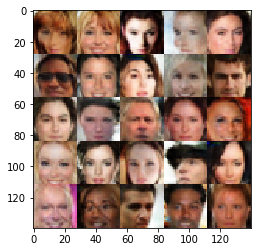

epoch=4 batch=4900 d_loss=0.823555 g_loss=1.69683


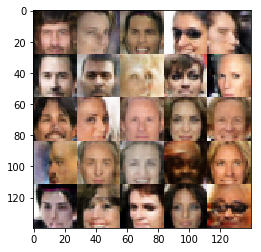

epoch=4 batch=5000 d_loss=0.823897 g_loss=1.69559


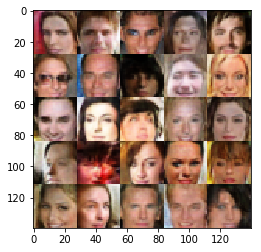

epoch=4 batch=5100 d_loss=0.823863 g_loss=1.69295


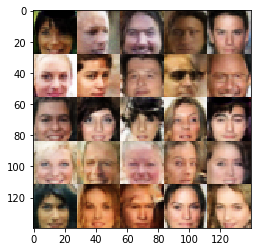

epoch=4 batch=5200 d_loss=0.824679 g_loss=1.69398


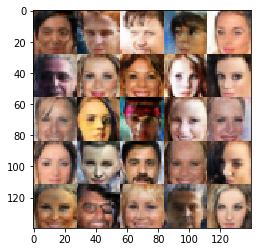

epoch=4 batch=5300 d_loss=0.826204 g_loss=1.69261


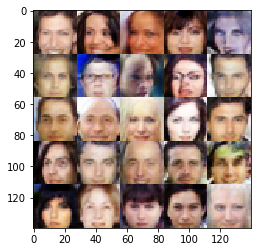

epoch=4 batch=5400 d_loss=0.826126 g_loss=1.69061


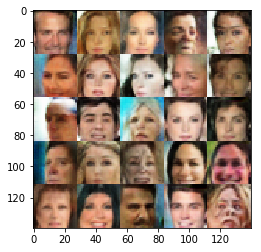

epoch=4 batch=5500 d_loss=0.825945 g_loss=1.69186


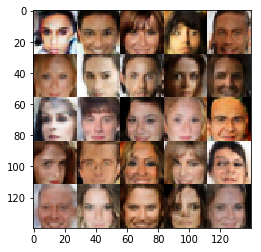

epoch=4 batch=5600 d_loss=0.825292 g_loss=1.6917


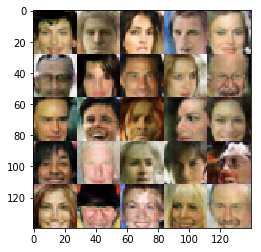

epoch=4 batch=5700 d_loss=0.82559 g_loss=1.69216


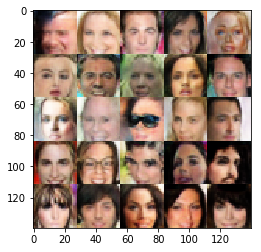

epoch=4 batch=5800 d_loss=0.825738 g_loss=1.69297


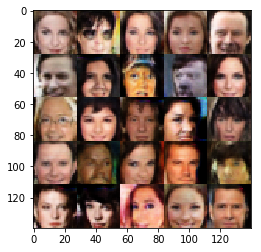

epoch=4 batch=5900 d_loss=0.825016 g_loss=1.69491


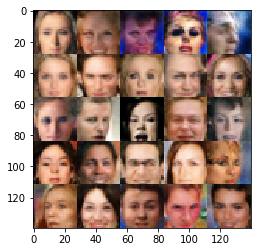

epoch=4 batch=6000 d_loss=0.824471 g_loss=1.69383


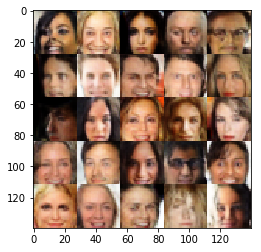

epoch=4 batch=6100 d_loss=0.82567 g_loss=1.69062


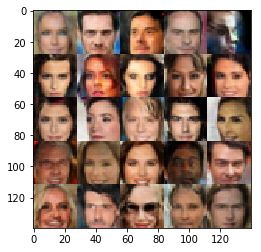

epoch=4 batch=6200 d_loss=0.825763 g_loss=1.6891


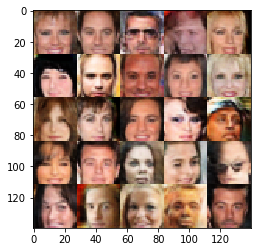

epoch=4 batch=6300 d_loss=0.825372 g_loss=1.68832


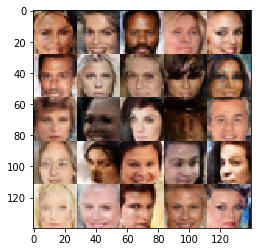

epoch=5 batch=0 d_loss=0.950444 g_loss=4.83989


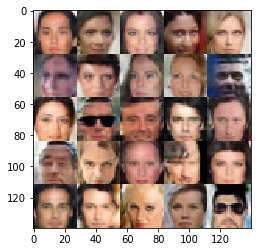

epoch=5 batch=100 d_loss=0.841427 g_loss=1.61217


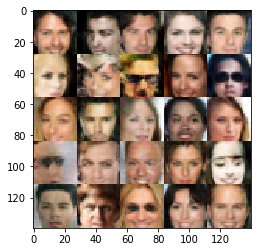

epoch=5 batch=200 d_loss=0.829596 g_loss=1.55802


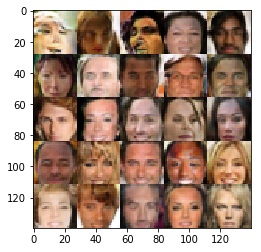

epoch=5 batch=300 d_loss=0.814829 g_loss=1.61312


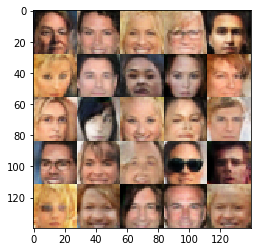

epoch=5 batch=400 d_loss=0.821207 g_loss=1.61036


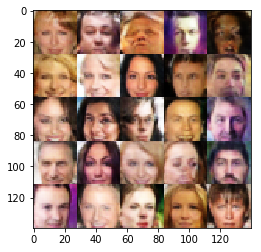

epoch=5 batch=500 d_loss=0.829921 g_loss=1.62465


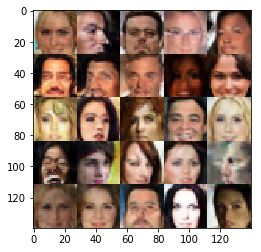

epoch=5 batch=600 d_loss=0.836885 g_loss=1.6276


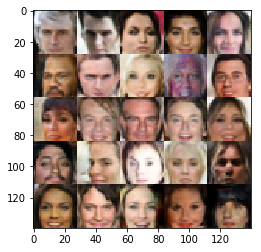

epoch=5 batch=700 d_loss=0.833932 g_loss=1.63345


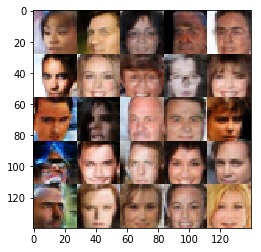

epoch=5 batch=800 d_loss=0.829616 g_loss=1.64106


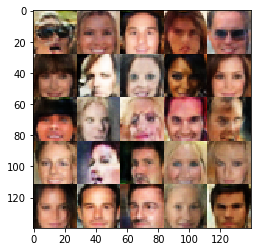

epoch=5 batch=900 d_loss=0.828089 g_loss=1.63416


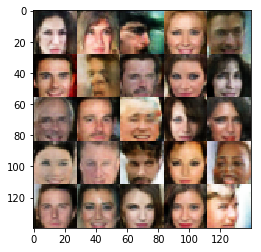

epoch=5 batch=1000 d_loss=0.825576 g_loss=1.63286


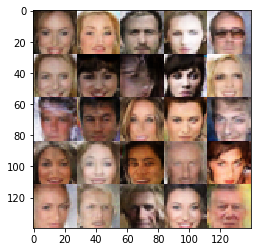

epoch=5 batch=1100 d_loss=0.823778 g_loss=1.65492


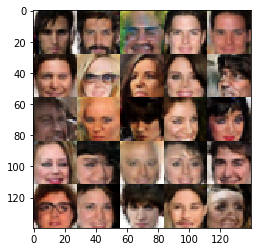

epoch=5 batch=1200 d_loss=0.825582 g_loss=1.66197


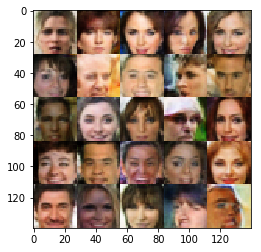

epoch=5 batch=1300 d_loss=0.823319 g_loss=1.6869


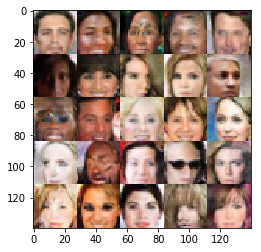

epoch=5 batch=1400 d_loss=0.825704 g_loss=1.66708


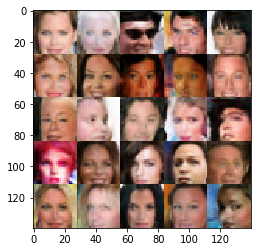

epoch=5 batch=1500 d_loss=0.827388 g_loss=1.66091


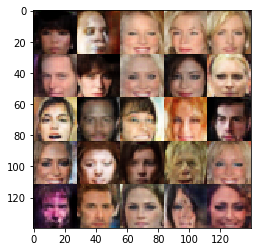

epoch=5 batch=1600 d_loss=0.829949 g_loss=1.65746


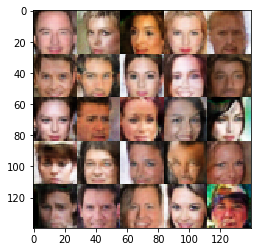

epoch=5 batch=1700 d_loss=0.830215 g_loss=1.66215


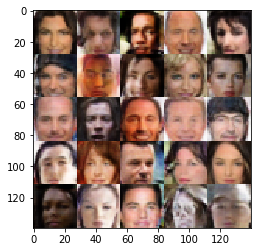

epoch=5 batch=1800 d_loss=0.830865 g_loss=1.66032


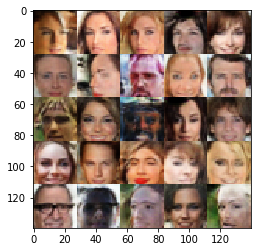

epoch=5 batch=1900 d_loss=0.832242 g_loss=1.65976


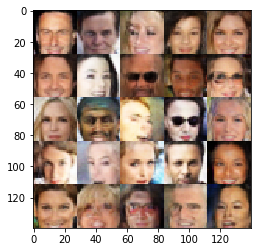

epoch=5 batch=2000 d_loss=0.830897 g_loss=1.66645


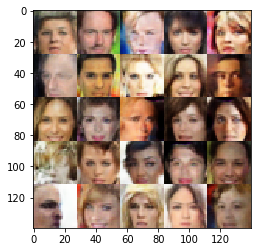

epoch=5 batch=2100 d_loss=0.828919 g_loss=1.66577


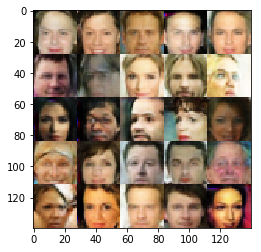

epoch=5 batch=2200 d_loss=0.830293 g_loss=1.6667


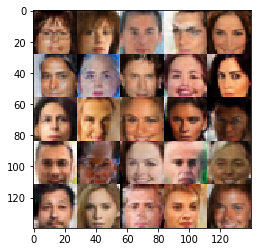

epoch=5 batch=2300 d_loss=0.826729 g_loss=1.6709


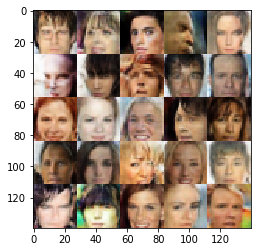

epoch=5 batch=2400 d_loss=0.827736 g_loss=1.67432


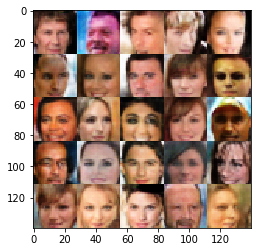

epoch=5 batch=2500 d_loss=0.826395 g_loss=1.67693


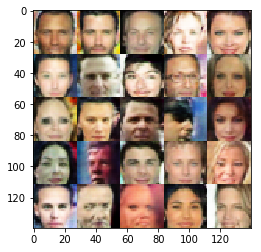

epoch=5 batch=2600 d_loss=0.825888 g_loss=1.6826


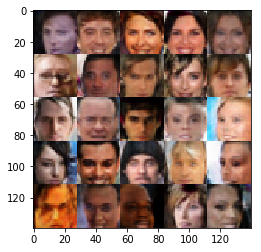

epoch=5 batch=2700 d_loss=0.824841 g_loss=1.68464


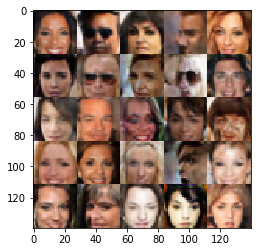

epoch=5 batch=2800 d_loss=0.823325 g_loss=1.68671


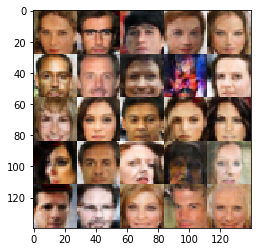

epoch=5 batch=2900 d_loss=0.824581 g_loss=1.68367


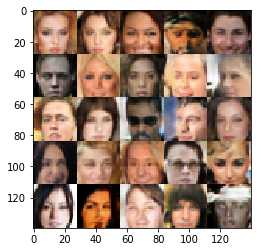

epoch=5 batch=3000 d_loss=0.828056 g_loss=1.67898


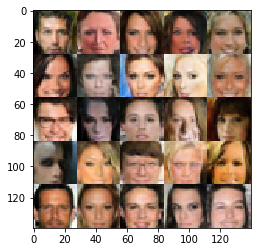

epoch=5 batch=3100 d_loss=0.830849 g_loss=1.67935


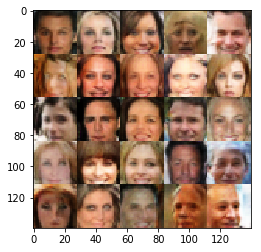

epoch=5 batch=3200 d_loss=0.82884 g_loss=1.68305


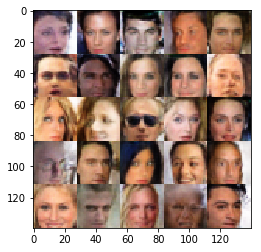

epoch=5 batch=3300 d_loss=0.82944 g_loss=1.68488


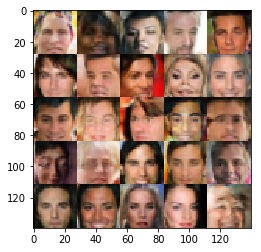

epoch=5 batch=3400 d_loss=0.829297 g_loss=1.68696


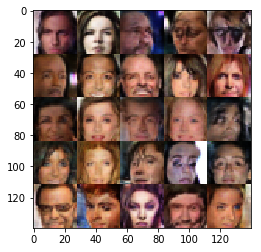

epoch=5 batch=3500 d_loss=0.828633 g_loss=1.70021


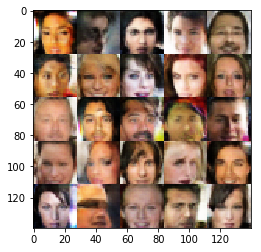

epoch=5 batch=3600 d_loss=0.826306 g_loss=1.71699


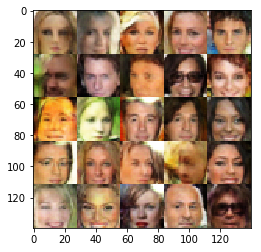

epoch=5 batch=3700 d_loss=0.82476 g_loss=1.72665


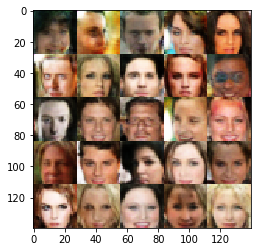

epoch=5 batch=3800 d_loss=0.822831 g_loss=1.73451


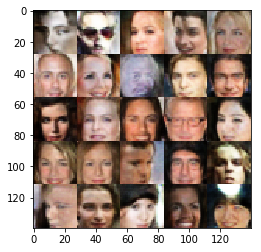

epoch=5 batch=3900 d_loss=0.820558 g_loss=1.74301


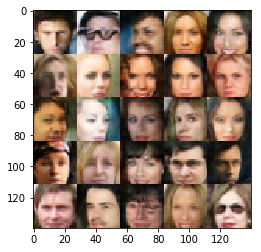

epoch=5 batch=4000 d_loss=0.819082 g_loss=1.75184


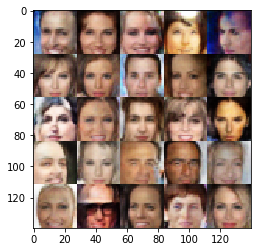

epoch=5 batch=4100 d_loss=0.81864 g_loss=1.75214


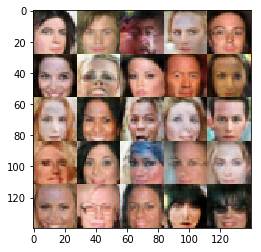

epoch=5 batch=4200 d_loss=0.816702 g_loss=1.75506


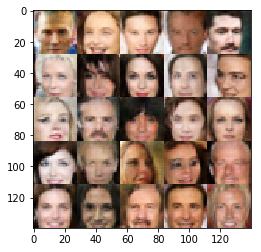

epoch=5 batch=4300 d_loss=0.815111 g_loss=1.76196


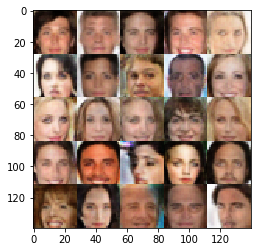

epoch=5 batch=4400 d_loss=0.814738 g_loss=1.76832


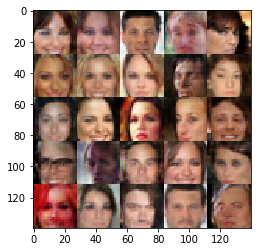

epoch=5 batch=4500 d_loss=0.81376 g_loss=1.77131


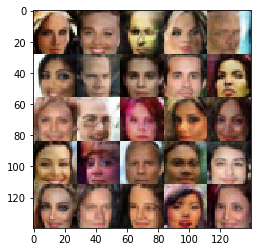

epoch=5 batch=4600 d_loss=0.812743 g_loss=1.77908


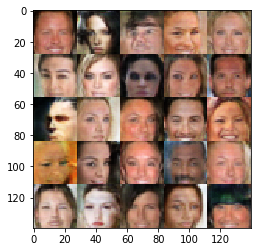

epoch=5 batch=4700 d_loss=0.813338 g_loss=1.77736


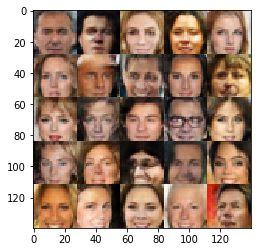

epoch=5 batch=4800 d_loss=0.81285 g_loss=1.77933


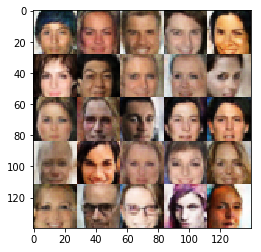

epoch=5 batch=4900 d_loss=0.81283 g_loss=1.77823


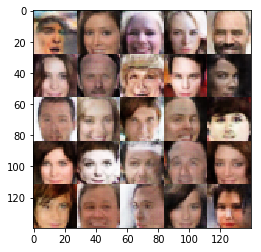

epoch=5 batch=5000 d_loss=0.814606 g_loss=1.77456


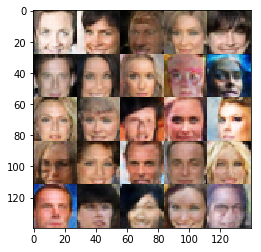

epoch=5 batch=5100 d_loss=0.815345 g_loss=1.7713


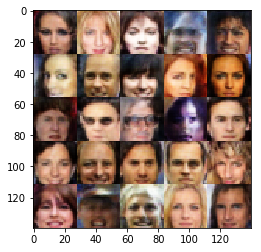

epoch=5 batch=5200 d_loss=0.815871 g_loss=1.77061


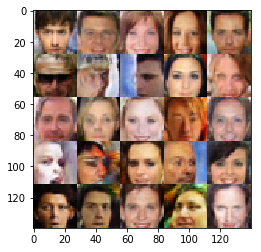

epoch=5 batch=5300 d_loss=0.817051 g_loss=1.77001


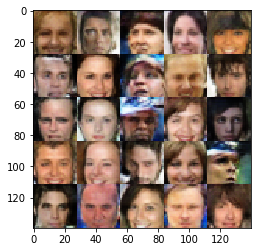

epoch=5 batch=5400 d_loss=0.81592 g_loss=1.77116


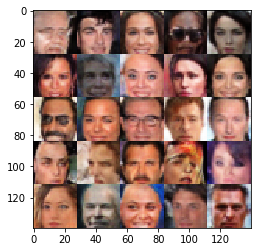

epoch=5 batch=5500 d_loss=0.815842 g_loss=1.77204


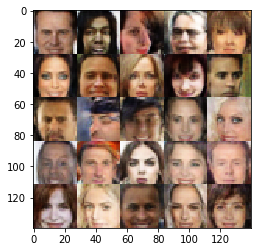

epoch=5 batch=5600 d_loss=0.816271 g_loss=1.77099


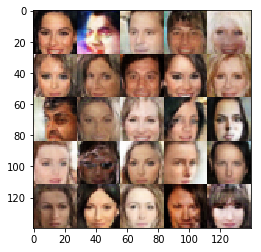

epoch=5 batch=5700 d_loss=0.815586 g_loss=1.77135


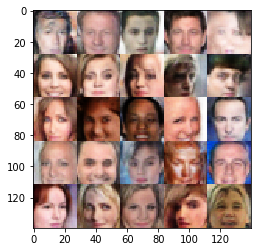

epoch=5 batch=5800 d_loss=0.816437 g_loss=1.76925


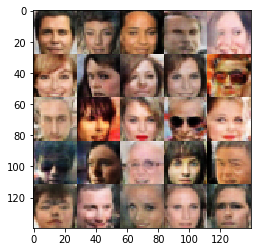

epoch=5 batch=5900 d_loss=0.816066 g_loss=1.76825


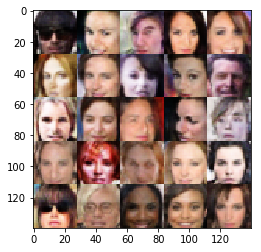

epoch=5 batch=6000 d_loss=0.818396 g_loss=1.7649


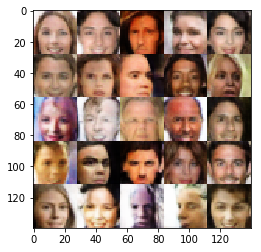

epoch=5 batch=6100 d_loss=0.818774 g_loss=1.76219


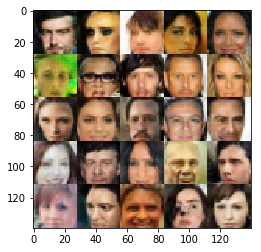

epoch=5 batch=6200 d_loss=0.820689 g_loss=1.75823


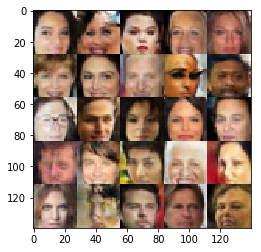

epoch=5 batch=6300 d_loss=0.821396 g_loss=1.75483


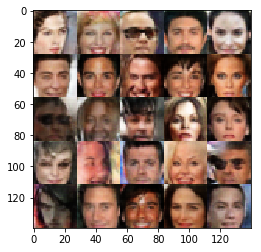

epoch=6 batch=0 d_loss=0.880241 g_loss=4.25709


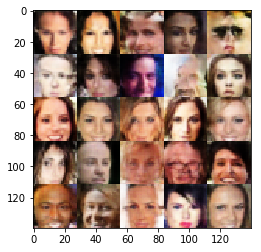

epoch=6 batch=100 d_loss=0.881005 g_loss=1.7432


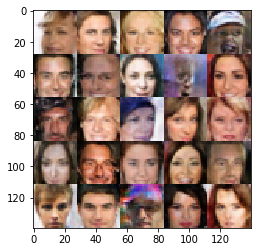

epoch=6 batch=200 d_loss=0.859476 g_loss=1.70453


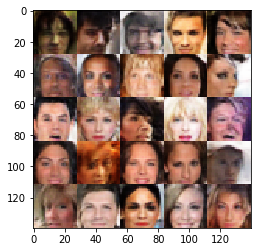

epoch=6 batch=300 d_loss=0.844469 g_loss=1.70313


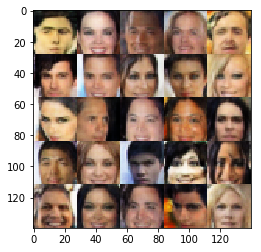

epoch=6 batch=400 d_loss=0.843504 g_loss=1.66266


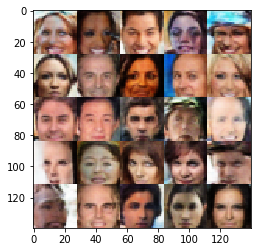

epoch=6 batch=500 d_loss=0.859492 g_loss=1.63996


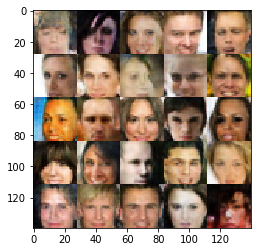

epoch=6 batch=600 d_loss=0.861032 g_loss=1.63009


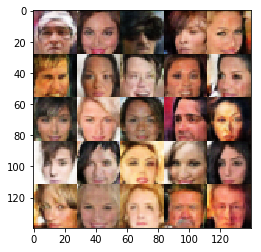

epoch=6 batch=700 d_loss=0.86369 g_loss=1.6168


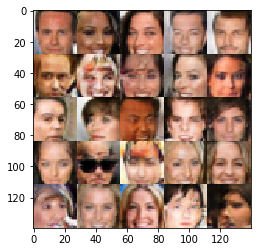

epoch=6 batch=800 d_loss=0.865305 g_loss=1.61908


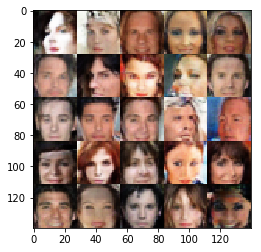

epoch=6 batch=900 d_loss=0.867252 g_loss=1.61345


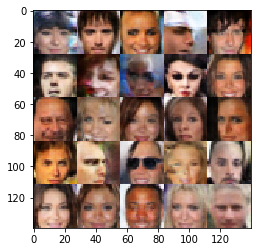

epoch=6 batch=1000 d_loss=0.866137 g_loss=1.60606


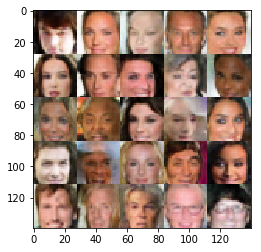

epoch=6 batch=1100 d_loss=0.865668 g_loss=1.61102


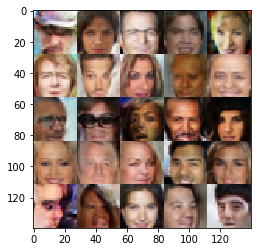

epoch=6 batch=1200 d_loss=0.867449 g_loss=1.60591


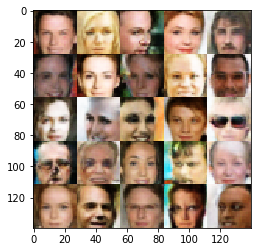

epoch=6 batch=1300 d_loss=0.867759 g_loss=1.61388


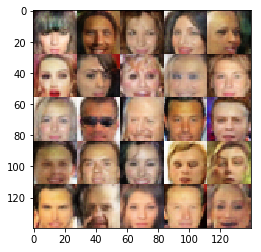

epoch=6 batch=1400 d_loss=0.875112 g_loss=1.60827


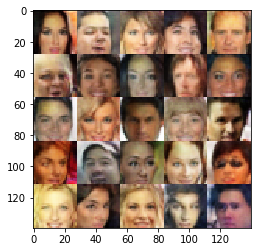

epoch=6 batch=1500 d_loss=0.872342 g_loss=1.61094


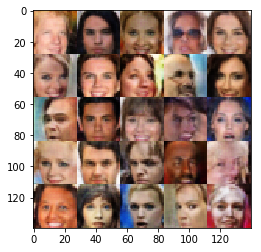

epoch=6 batch=1600 d_loss=0.872014 g_loss=1.59968


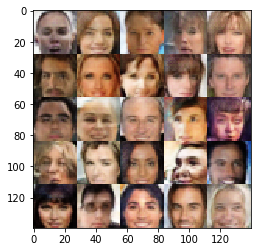

epoch=6 batch=1700 d_loss=0.868894 g_loss=1.60226


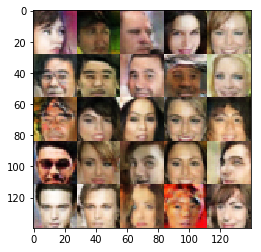

epoch=6 batch=1800 d_loss=0.871409 g_loss=1.59965


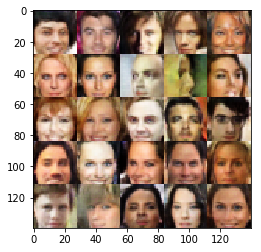

epoch=6 batch=1900 d_loss=0.873871 g_loss=1.59914


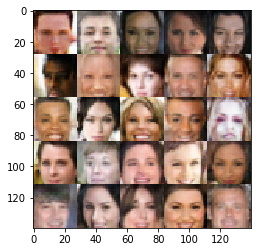

epoch=6 batch=2000 d_loss=0.874 g_loss=1.60171


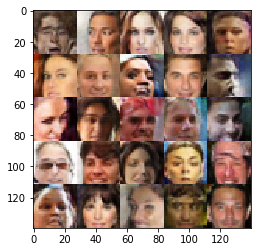

epoch=6 batch=2100 d_loss=0.873083 g_loss=1.59754


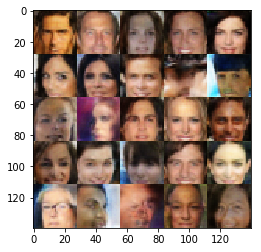

epoch=6 batch=2200 d_loss=0.870497 g_loss=1.60344


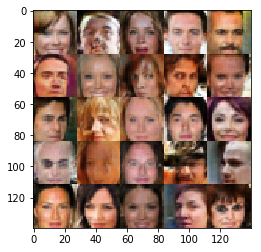

epoch=6 batch=2300 d_loss=0.86748 g_loss=1.61373


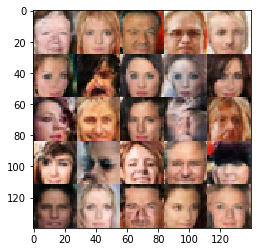

epoch=6 batch=2400 d_loss=0.86697 g_loss=1.61727


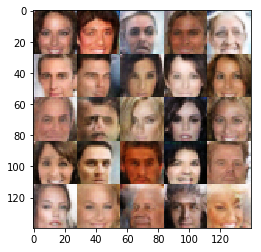

epoch=6 batch=2500 d_loss=0.865902 g_loss=1.61991


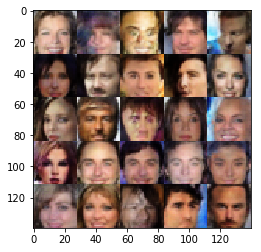

epoch=6 batch=2600 d_loss=0.867332 g_loss=1.62411


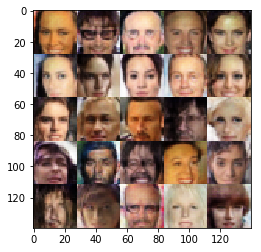

epoch=6 batch=2700 d_loss=0.866072 g_loss=1.62266


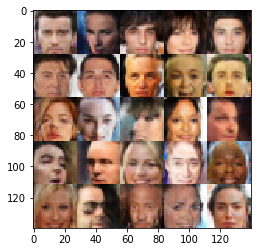

epoch=6 batch=2800 d_loss=0.867188 g_loss=1.61812


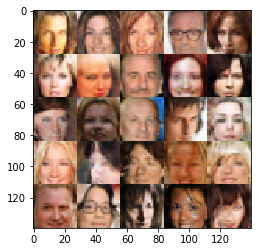

epoch=6 batch=2900 d_loss=0.867069 g_loss=1.61674


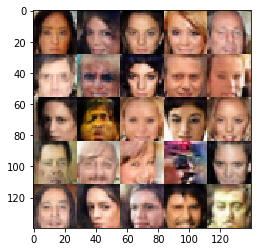

epoch=6 batch=3000 d_loss=0.868999 g_loss=1.60775


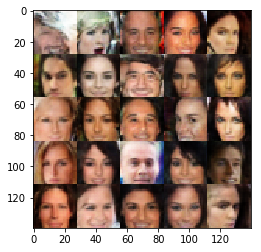

epoch=6 batch=3100 d_loss=0.868272 g_loss=1.6087


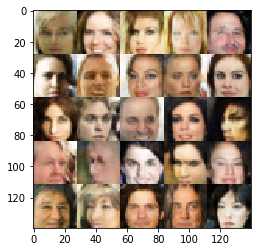

epoch=6 batch=3200 d_loss=0.867195 g_loss=1.61


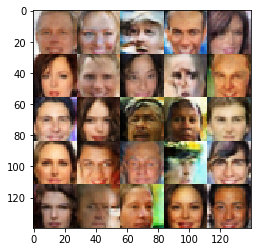

epoch=6 batch=3300 d_loss=0.868237 g_loss=1.60703


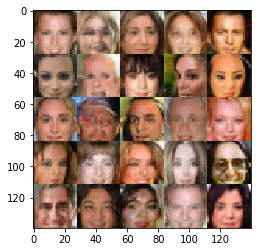

epoch=6 batch=3400 d_loss=0.866393 g_loss=1.60732


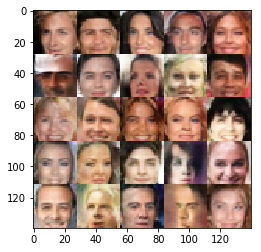

epoch=6 batch=3500 d_loss=0.86457 g_loss=1.615


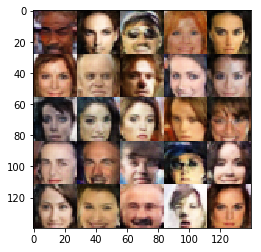

epoch=6 batch=3600 d_loss=0.86518 g_loss=1.61465


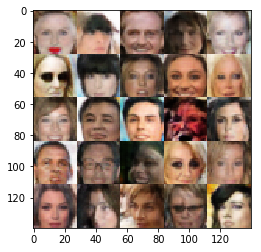

epoch=6 batch=3700 d_loss=0.866411 g_loss=1.61753


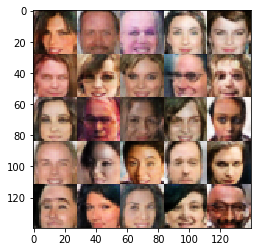

epoch=6 batch=3800 d_loss=0.866189 g_loss=1.61774


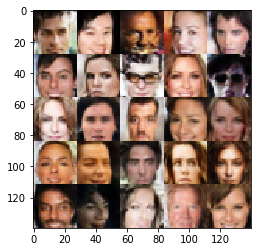

epoch=6 batch=3900 d_loss=0.866973 g_loss=1.61777


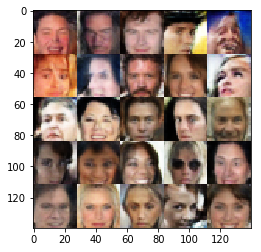

epoch=6 batch=4000 d_loss=0.865536 g_loss=1.62128


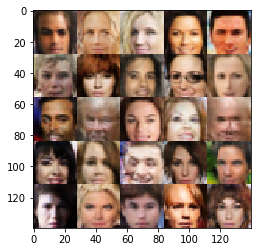

epoch=6 batch=4100 d_loss=0.866202 g_loss=1.61812


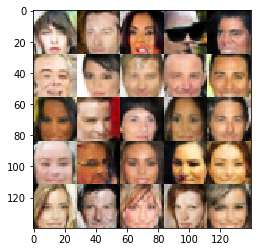

epoch=6 batch=4200 d_loss=0.863481 g_loss=1.62286


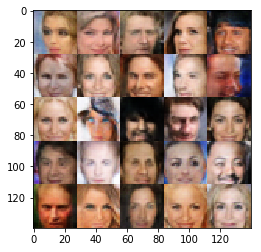

epoch=6 batch=4300 d_loss=0.861642 g_loss=1.62686


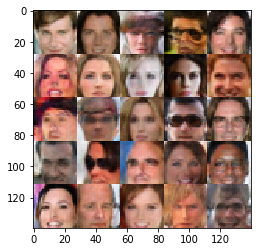

epoch=6 batch=4400 d_loss=0.862839 g_loss=1.63063


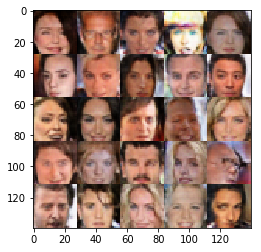

epoch=6 batch=4500 d_loss=0.861777 g_loss=1.63367


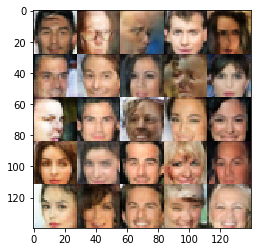

epoch=6 batch=4600 d_loss=0.860651 g_loss=1.63264


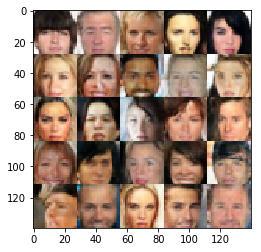

epoch=6 batch=4700 d_loss=0.85918 g_loss=1.63793


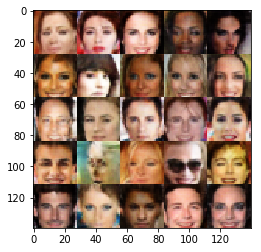

epoch=6 batch=4800 d_loss=0.858041 g_loss=1.64136


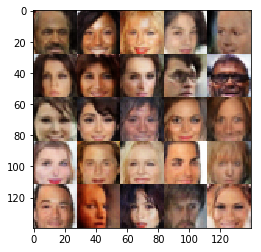

epoch=6 batch=4900 d_loss=0.857896 g_loss=1.64266


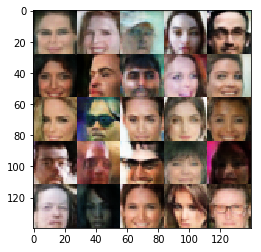

epoch=6 batch=5000 d_loss=0.858121 g_loss=1.64418


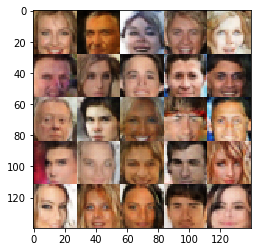

epoch=6 batch=5100 d_loss=0.856241 g_loss=1.64446


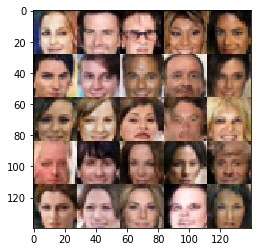

epoch=6 batch=5200 d_loss=0.856785 g_loss=1.6436


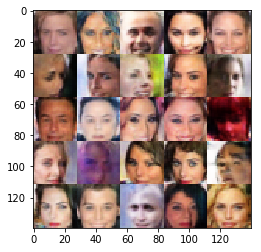

epoch=6 batch=5300 d_loss=0.855246 g_loss=1.64714


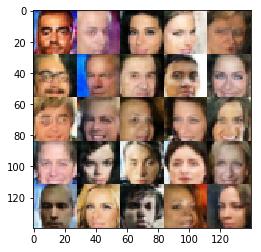

epoch=6 batch=5400 d_loss=0.854232 g_loss=1.6494


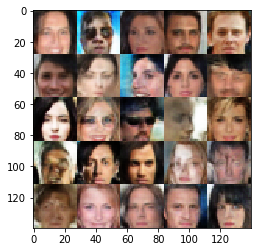

epoch=6 batch=5500 d_loss=0.853216 g_loss=1.65266


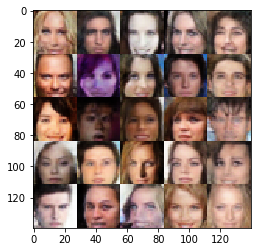

epoch=6 batch=5600 d_loss=0.852196 g_loss=1.65279


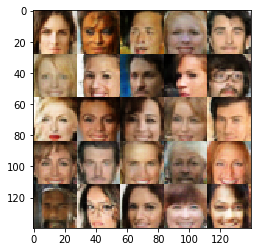

epoch=6 batch=5700 d_loss=0.850897 g_loss=1.65552


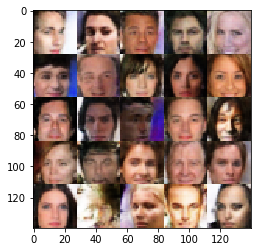

epoch=6 batch=5800 d_loss=0.852323 g_loss=1.65528


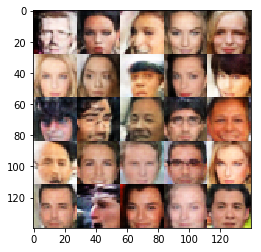

epoch=6 batch=5900 d_loss=0.852098 g_loss=1.65969


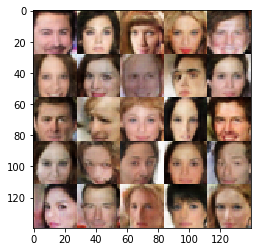

epoch=6 batch=6000 d_loss=0.852362 g_loss=1.65921


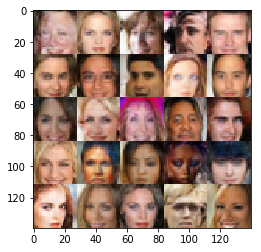

epoch=6 batch=6100 d_loss=0.851918 g_loss=1.65849


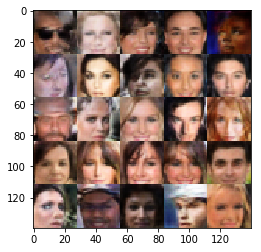

epoch=6 batch=6200 d_loss=0.852216 g_loss=1.65726


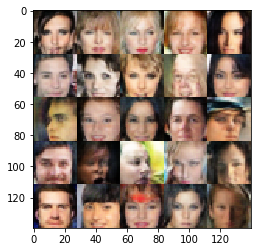

epoch=6 batch=6300 d_loss=0.851683 g_loss=1.6585
Finished


In [27]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 7

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.